In [1]:
import numpy as np
import pandas as pd
import os
print(os.listdir("../predict_future_sales/input/"))
import matplotlib.pyplot as plt
import seaborn as sns
from xgboost import plot_importance
import gc

['sales_train.csv', 'Untitled.ipynb', 'shops.csv', 'test.csv', 'item_categories.csv', 'items.csv', 'sample_submission.csv']


In [2]:
def plot_features(booster, figsize):    
    fig, ax = plt.subplots(1,1,figsize=figsize)
    return plot_importance(booster=booster, ax=ax)

In [3]:
pd.get_option("display.max_columns")

#最大表示列数の指定（ここでは50列を指定）
pd.set_option('display.max_columns', 120)
#現在の最大表示行数の出力
pd.get_option("display.max_rows")

#最大表示行数の指定（ここでは50行を指定）
pd.set_option('display.max_rows', 300)

In [4]:
DATA_FOLDER = '../predict_future_sales/input'

transactions = pd.read_csv('input/sales_train.csv')
items = pd.read_csv('input/items.csv')
item_categories = pd.read_csv('input/item_categories.csv')
shops = pd.read_csv(os.path.join(DATA_FOLDER,'shops.csv'))


In [5]:
test = pd.read_csv(os.path.join(DATA_FOLDER,'test.csv'))

In [6]:
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,02.01.2013,0,59,22154,999.00,1.0
1,03.01.2013,0,25,2552,899.00,1.0
2,05.01.2013,0,25,2552,899.00,-1.0
3,06.01.2013,0,25,2554,1709.05,1.0
4,15.01.2013,0,25,2555,1099.00,1.0


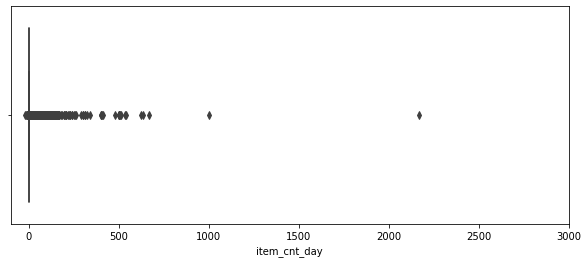

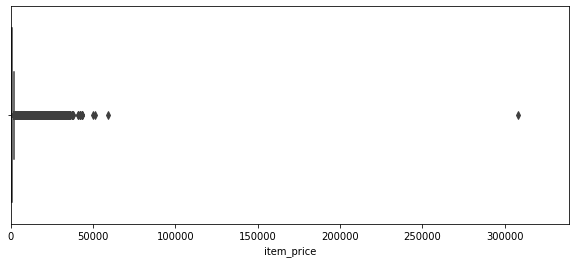

In [7]:
plt.figure(figsize=(10,4))
plt.xlim(-100, 3000)
sns.boxplot(x=transactions.item_cnt_day)

plt.figure(figsize=(10,4))
plt.xlim(transactions.item_price.min(), transactions.item_price.max()*1.1)
sns.boxplot(x=transactions.item_price)

In [8]:
transactions = transactions[transactions.item_cnt_day < 1001]
transactions  = transactions[transactions.item_price < 100000]

In [9]:
items.head(5)

,item_name,item_id,item_category_id
0,! ВО ВЛАСТИ НАВАЖДЕНИЯ (ПЛАСТ.) D,0,40
1,!ABBYY FineReader 12 Professional Edition Full...,1,76
2,***В ЛУЧАХ СЛАВЫ (UNV) D,2,40
3,***ГОЛУБАЯ ВОЛНА (Univ) D,3,40
4,***КОРОБКА (СТЕКЛО) D,4,40


In [10]:
item_categories.head(5)

,item_category_name,item_category_id
0,PC - Гарнитуры/Наушники,0
1,Аксессуары - PS2,1
2,Аксессуары - PS3,2
3,Аксессуары - PS4,3
4,Аксессуары - PSP,4


In [11]:
shops.head(10)

,shop_name,shop_id
0,"!Якутск Орджоникидзе, 56 фран",0
1,"!Якутск ТЦ ""Центральный"" фран",1
2,"Адыгея ТЦ ""Мега""",2
3,"Балашиха ТРК ""Октябрь-Киномир""",3
4,"Волжский ТЦ ""Волга Молл""",4
5,"Вологда ТРЦ ""Мармелад""",5
6,"Воронеж (Плехановская, 13)",6
7,"Воронеж ТРЦ ""Максимир""",7
8,"Воронеж ТРЦ Сити-Парк ""Град""",8
9,Выездная Торговля,9


In [12]:
shops['city_name'] = shops['shop_name'].map(lambda x:x.split(' ')[0])
shops['city_name'].value_counts()

Москва              13
РостовНаДону         3
Тюмень               3
Воронеж              3
СПб                  2
Казань               2
Н.Новгород           2
Уфа                  2
Красноярск           2
Жуковский            2
!Якутск              2
Самара               2
Якутск               2
Новосибирск          2
Адыгея               1
Калуга               1
Сергиев              1
Вологда              1
Чехов                1
Сургут               1
Волжский             1
Мытищи               1
Ярославль            1
Томск                1
Выездная             1
Интернет-магазин     1
Курск                1
Балашиха             1
Омск                 1
Химки                1
Коломна              1
Цифровой             1
Name: city_name, dtype: int64

In [13]:
shops.loc[shops['city_name'] == '!Якутск', 'city_name'] = 'Якутск'
shops.city_name.value_counts()

Москва              13
Якутск               4
РостовНаДону         3
Воронеж              3
Тюмень               3
Красноярск           2
СПб                  2
Казань               2
Новосибирск          2
Самара               2
Жуковский            2
Уфа                  2
Н.Новгород           2
Адыгея               1
Мытищи               1
Калуга               1
Вологда              1
Сургут               1
Сергиев              1
Волжский             1
Ярославль            1
Томск                1
Выездная             1
Интернет-магазин     1
Курск                1
Балашиха             1
Омск                 1
Чехов                1
Химки                1
Коломна              1
Цифровой             1
Name: city_name, dtype: int64

In [14]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [15]:
item_categories['split'] = item_categories['item_category_name'].str.split(' - ')
item_categories['type'] = item_categories['split'].map(lambda x:x[0].strip())
item_categories['subtype'] = item_categories['split'].map(lambda x:x[1].strip() if len(x) > 1 else x[0].strip())
item_categories['type'] = le.fit_transform(item_categories['type'])
item_categories['subtype'] = le.fit_transform(item_categories['subtype'])

item_categories = item_categories[['type','subtype','item_category_id']]

In [16]:
shops['city_name'] = le.fit_transform(shops['city_name'])

encoding = shops.groupby('city_name').size()
encoding = encoding / len(shops)
shops['city_frequency'] = shops.city_name.map(encoding)
shops.city_frequency.describe()

# encoding = test.groupby('item_id').size()
# encoding = encoding/len(test)
# test['item_freq'] = test.item_id.map(encoding)

count    60.000000
mean      0.072778
std       0.077628
min       0.016667
25%       0.016667
50%       0.033333
75%       0.066667
max       0.216667
Name: city_frequency, dtype: float64

In [17]:
transactions = pd.merge(transactions, items, on='item_id', how='left')
transactions = transactions.drop('item_name',axis=1)
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
0,02.01.2013,0,59,22154,999.00,1.0,37
1,03.01.2013,0,25,2552,899.00,1.0,58
2,05.01.2013,0,25,2552,899.00,-1.0,58
3,06.01.2013,0,25,2554,1709.05,1.0,58
4,15.01.2013,0,25,2555,1099.00,1.0,56


In [18]:
transactions = pd.merge(transactions, shops, on='shop_id', how='left')
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id,shop_name,city_name,city_frequency
0,02.01.2013,0,59,22154,999.00,1.0,37,"Ярославль ТЦ ""Альтаир""",30,0.016667
1,03.01.2013,0,25,2552,899.00,1.0,58,"Москва ТРК ""Атриум""",13,0.216667
2,05.01.2013,0,25,2552,899.00,-1.0,58,"Москва ТРК ""Атриум""",13,0.216667
3,06.01.2013,0,25,2554,1709.05,1.0,58,"Москва ТРК ""Атриум""",13,0.216667
4,15.01.2013,0,25,2555,1099.00,1.0,56,"Москва ТРК ""Атриум""",13,0.216667


In [19]:
from itertools import product
index_col = ['shop_id','item_id','date_block_num']

In [20]:
grid = []
for block_num in transactions['date_block_num'].unique():
    cur_shops = transactions.loc[transactions['date_block_num'] == block_num, 'shop_id'].unique()
    #This shows all shops in three countries working in each month
    cur_items = transactions.loc[transactions['date_block_num']==block_num,'item_id'].unique()
    grid.append(np.array(list(product(*[cur_shops,cur_items,[block_num]])),dtype='int32'))
grid = pd.DataFrame(np.vstack(grid),columns=index_col,dtype=np.int32)
grid.head(15)

,shop_id,item_id,date_block_num
0,59,22154,0
1,59,2552,0
2,59,2554,0
3,59,2555,0
4,59,2564,0
5,59,2565,0
6,59,2572,0
7,59,2573,0
8,59,2574,0
9,59,2593,0


## Make statistical features

In [21]:
mean_transactions = transactions.groupby(['date_block_num','shop_id','item_id']).agg({'item_cnt_day':'sum','item_price':np.mean}).reset_index()

mean_transactions.head(5)

,date_block_num,shop_id,item_id,item_cnt_day,item_price
0,0,0,32,6.0,221.0
1,0,0,33,3.0,347.0
2,0,0,35,1.0,247.0
3,0,0,43,1.0,221.0
4,0,0,51,2.0,128.5


In [22]:
mean_transactions.columns = ['date_block_num','shop_id','item_id','item_cnt_month','item_price']

In [23]:
mean_transactions.item_cnt_month.describe()

count    1.609123e+06
mean     2.265853e+00
std      8.466196e+00
min     -2.200000e+01
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      1.644000e+03
Name: item_cnt_month, dtype: float64

In [24]:
mean_transactions.item_cnt_month = mean_transactions.item_cnt_month.clip(0,20)
mean_transactions.item_cnt_month.describe()

count    1.609123e+06
mean     2.022807e+00
std      2.577964e+00
min      0.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      2.000000e+01
Name: item_cnt_month, dtype: float64

In [25]:
mean_transactions = pd.merge(grid, mean_transactions, on=['date_block_num','shop_id','item_id'],how='left').fillna(0)
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price
0,59,22154,0,1.0,999.0
1,59,2552,0,0.0,0.0
2,59,2554,0,0.0,0.0
3,59,2555,0,0.0,0.0
4,59,2564,0,0.0,0.0
5,59,2565,0,0.0,0.0
6,59,2572,0,0.0,0.0
7,59,2573,0,0.0,0.0
8,59,2574,0,2.0,399.0
9,59,2593,0,0.0,0.0


In [26]:
mean_transactions = pd.merge(mean_transactions, items, on='item_id',how='left')
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id
0,59,22154,0,1.0,999.0,ЯВЛЕНИЕ 2012 (BD),37
1,59,2552,0,0.0,0.0,DEEP PURPLE The House Of Blue Light LP,58
2,59,2554,0,0.0,0.0,DEEP PURPLE Who Do You Think We Are LP,58
3,59,2555,0,0.0,0.0,DEEP PURPLE 30 Very Best Of 2CD (Фирм.),56
4,59,2564,0,0.0,0.0,DEEP PURPLE Perihelion: Live In Concert DVD (К...,59
5,59,2565,0,0.0,0.0,DEEP PURPLE Stormbringer (фирм.),56
6,59,2572,0,0.0,0.0,DEFTONES Koi No Yokan,55
7,59,2573,0,0.0,0.0,DEL REY LANA Born To Die,55
8,59,2574,0,2.0,399.0,DEL REY LANA Born To Die The Paradise Editio...,55
9,59,2593,0,0.0,0.0,DEPECHE MODE Music For The Masses,55


In [27]:
shops.drop('shop_name',axis=1,inplace=True)
shops['city_name'].value_counts()

13    13
29     4
24     3
4      3
18     3
15     2
19     2
8      2
16     2
20     2
6      2
25     2
11     2
10     1
5      1
7      1
3      1
2      1
1      1
9      1
30     1
12     1
14     1
17     1
21     1
22     1
23     1
26     1
27     1
28     1
0      1
Name: city_name, dtype: int64

In [28]:
mean_transactions = pd.merge(mean_transactions, shops, on=['shop_id'], how='left')

In [29]:
mean_transactions = pd.merge(mean_transactions, item_categories, on = ['item_category_id'], how='left')

In [30]:
mean_transactions = mean_transactions[mean_transactions.date_block_num > 12]

In [31]:
test['date_block_num'] = 34
test  = pd.merge(test, items, on=['item_id'], how='left')
test = pd.merge(test, shops, on= ['shop_id'], how='left')
test = pd.merge(test, item_categories, on=['item_category_id'], how='left')

In [32]:
test.head(5)

,ID,shop_id,item_id,date_block_num,item_name,item_category_id,city_name,city_frequency,type,subtype
0,0,5,5037,34,"NHL 15 [PS3, русские субтитры]",19,3,0.016667,5,12
1,1,5,5320,34,ONE DIRECTION Made In The A.M.,55,3,0.016667,13,4
2,2,5,5233,34,"Need for Speed Rivals (Essentials) [PS3, русск...",19,3,0.016667,5,12
3,3,5,5232,34,"Need for Speed Rivals (Classics) [Xbox 360, ру...",23,3,0.016667,5,18
4,4,5,5268,34,"Need for Speed [PS4, русская версия]",20,3,0.016667,5,13


In [33]:
def downcast_dtypes(df):
    '''
        Changes column types in the dataframe: 
                
                `float64` type to `float32`
                `int64`   type to `int32`
    '''
    
    # Select columns to downcast
    float_cols = [c for c in df if df[c].dtype == "float64"]
    int_cols =   [c for c in df if df[c].dtype == "int64"]
    
    # Downcast
    df[float_cols] = df[float_cols].astype(np.float32)
    df[int_cols]   = df[int_cols].astype(np.int32)
    
    return df

In [34]:
transactions['sales'] = transactions['item_cnt_day'] * transactions['item_price']

In [35]:
mean_transactions['product_sales'] = mean_transactions['item_cnt_month'] * mean_transactions['item_price']

In [36]:
mean_transactions.describe()

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_category_id,city_name,city_frequency,type,subtype,product_sales
count,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06,6.077748e+06
mean,3.192010e+01,1.126758e+04,2.214524e+01,2.863789e-01,1.286166e+02,4.493309e+01,1.555280e+01,6.820031e-02,1.099190e+01,2.128221e+01,3.076319e+02
std,1.723802e+01,6.275926e+03,5.898870e+00,1.184929e+00,7.375173e+02,1.574783e+01,7.981796e+00,7.527969e-02,2.979823e+00,2.109850e+01,3.388639e+03
min,2.000000e+00,0.000000e+00,1.300000e+01,0.000000e+00,0.000000e+00,2.000000e+00,0.000000e+00,1.666667e-02,1.000000e+00,0.000000e+00,0.000000e+00
25%,1.700000e+01,5.679000e+03,1.700000e+01,0.000000e+00,0.000000e+00,3.700000e+01,1.100000e+01,1.666667e-02,1.100000e+01,4.000000e+00,0.000000e+00
50%,3.300000e+01,1.137300e+04,2.200000e+01,0.000000e+00,0.000000e+00,4.000000e+01,1.400000e+01,3.333333e-02,1.100000e+01,1.200000e+01,0.000000e+00
75%,4.700000e+01,1.654100e+04,2.700000e+01,0.000000e+00,0.000000e+00,5.600000e+01,2.200000e+01,5.000000e-02,1.300000e+01,3.700000e+01,0.000000e+00
max,5.900000e+01,2.216900e+04,3.300000e+01,2.000000e+01,5.099900e+04,8.300000e+01,3.000000e+01,2.166667e-01,1.900000e+01,6.600000e+01,5.998000e+05


In [37]:
lower = np.percentile(mean_transactions.item_price,95)
mean_transactions.item_price = mean_transactions.item_price.clip(0,lower)


lower = np.percentile(mean_transactions.product_sales,95)
mean_transactions.product_sales = mean_transactions.item_price.clip(0,lower)

## I will make the similar dataframe about statistical features, but this time, these are lag features

In [38]:
item_mean = transactions.groupby(['item_id','date_block_num']).mean().reset_index()\
                        [['item_id','item_price','item_cnt_day','date_block_num','sales']]
item_mean.columns = ['item_id','item_price_per_item','item_cnt_day_per_item','date_block_num','sales_per_item']



item_std =transactions.groupby(['item_id','date_block_num']).std().reset_index()\
                        [['item_id','item_price','item_cnt_day','date_block_num','sales']]
item_std.columns = ['item_id','price_std_per_item','cnt_day_std_per_item','date_block_num','sales_std_per_item']

In [39]:
mean_transactions = pd.merge(mean_transactions, item_mean, on=['date_block_num','item_id'],how='left')
mean_transactions = pd.merge(mean_transactions, item_std, on=['date_block_num','item_id'],how='left')
del item_mean
del item_std
gc.collect()


mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,699.0,666.750000,1.000000,666.750000,91.216775,0.000000,91.216775
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN
2,27,15279,13,2.0,699.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,699.0,799.000000,1.043478,833.739130,0.000000,0.206185,164.741472
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666667,1.000000,365.666667,115.470054,0.000000,115.470054
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526316,1.000000,545.526316,15.141438,0.000000,15.141438
5,27,14890,13,1.0,699.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,699.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,399.0,393.425532,1.074468,423.138298,26.583805,0.394570,160.707080
7,27,14913,13,1.0,699.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,699.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630
8,27,15227,13,2.0,699.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,699.0,2361.350000,1.000000,2361.350000,168.375919,0.000000,168.375919
9,27,14925,13,1.0,699.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,699.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000


In [40]:
mean_transactions = downcast_dtypes(mean_transactions)

gc.collect()

20

In [41]:
shop_mean_df = transactions.groupby(['date_block_num','shop_id']).mean().reset_index()\
                                 [['shop_id','date_block_num','item_cnt_day','item_price','sales']]
shop_mean_df.columns = ['shop_id','date_block_num','item_cnt_day_per_shop','item_price_per_shop','sales_per_shop']
mean_transactions = pd.merge(mean_transactions,shop_mean_df, on=['date_block_num','shop_id'],how='left')

shop_std_df =  transactions.groupby(['date_block_num','shop_id']).std().reset_index()\
                                 [['shop_id','date_block_num','item_cnt_day','item_price','sales']]
shop_std_df.columns = ['shop_id','date_block_num','cnt_day_std_shop','price_std_per_shop','sales_std_per_shop']
mean_transactions = pd.merge(mean_transactions,shop_std_df, on=['date_block_num','shop_id'],how='left')


del shop_mean_df
del shop_std_df
gc.collect()

0

In [42]:
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,699.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
2,27,15279,13,2.0,699.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,699.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
5,27,14890,13,1.0,699.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,699.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,399.0,393.425537,1.074468,423.138306,26.583805,0.394570,160.707077,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
7,27,14913,13,1.0,699.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,699.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
8,27,15227,13,2.0,699.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,699.0,2361.350098,1.000000,2361.350098,168.375916,0.000000,168.375916,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
9,27,14925,13,1.0,699.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,699.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548


In [43]:
category_mean_df = transactions.groupby(['date_block_num','item_category_id']).mean().reset_index()[['item_category_id','date_block_num','item_cnt_day','item_price','sales']]
category_mean_df.columns = ['item_category_id','date_block_num','item_cnt_day_per_category','item_price_per_category','sales_per_category']
mean_transactions = pd.merge(mean_transactions, category_mean_df, on=['date_block_num','item_category_id'],how='left')

In [44]:
category_std_df = transactions.groupby(['date_block_num','item_category_id']).std().reset_index()[['item_category_id','date_block_num','item_cnt_day','item_price','sales']]
category_std_df.columns = ['item_category_id','date_block_num','cnt_day_std_per_category','price_std_per_category','sales_std_per_category']
mean_transactions = pd.merge(mean_transactions, category_std_df, on=['date_block_num','item_category_id'],how='left')

In [45]:
shop_cat_df = transactions.groupby(['date_block_num', 'item_category_id', 'shop_id']).mean().reset_index()\
                          [['date_block_num', 'item_category_id', 'shop_id','item_cnt_day','item_price']]
shop_cat_df.columns = ['date_block_num','item_category_id','shop_id','cnt_day_shop_cat','price_shop_cat']
mean_transactions = pd.merge(mean_transactions, shop_cat_df, on=['date_block_num', 'item_category_id','shop_id'], how='left')

In [46]:
del category_mean_df
del category_std_df
del shop_cat_df
gc.collect()

60

In [47]:
mean_transactions = downcast_dtypes(mean_transactions)
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,699.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
2,27,15279,13,2.0,699.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,699.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603
5,27,14890,13,1.0,699.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,699.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,0.994792,1729.023438,1666.528687,0.102062,1264.996338,1346.467285,1.000000,1710.764648
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,399.0,393.425537,1.074468,423.138306,26.583805,0.394570,160.707077,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.115157,261.256531,303.425323,0.509787,121.250877,247.065536,1.140909,284.174988
7,27,14913,13,1.0,699.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,699.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.039731,410.838654,436.409668,0.300559,281.370209,356.970642,1.059633,427.159027
8,27,15227,13,2.0,699.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,699.0,2361.350098,1.000000,2361.350098,168.375916,0.000000,168.375916,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
9,27,14925,13,1.0,699.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,699.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.042735,1128.092285,1155.233765,0.360973,1107.490479,1225.665771,1.068966,1354.162109


In [48]:
mean_transactions.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,699.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
2,27,15279,13,2.0,699.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,699.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603


In [49]:
city_df = mean_transactions.groupby(['date_block_num','city_name']).mean().reset_index()\
                [['date_block_num','city_name','item_cnt_month','item_price']]
city_df.columns = ['date_block_num','city_name','item_cnt_day_city','item_price_city']
mean_transactions = pd.merge(mean_transactions, city_df, on=['date_block_num','city_name'], how='left')

del city_df
gc.collect()

0

In [50]:
cat_city_df = mean_transactions.groupby(['date_block_num','city_name','item_category_id']).mean().reset_index()\
                [['date_block_num','city_name','item_category_id','item_cnt_month','item_price']]
cat_city_df.columns = ['date_block_num','city_name','item_category_id','item_cnt_day_city_cat','item_price_city_cat']
mean_transactions = pd.merge(mean_transactions, cat_city_df, on=['date_block_num','city_name','item_category_id'], how='left')

del cat_city_df
gc.collect()

20

In [51]:
shop_cat_max_min = mean_transactions.groupby(['date_block_num','shop_id','item_category_id']).\
                                      agg(max_price_cat_shop=('item_price','max'), min_price_cat_shop=('item_price','min')).reset_index()\
                                        [['date_block_num','shop_id','item_category_id','max_price_cat_shop', 'min_price_cat_shop']]
mean_transactions = pd.merge(mean_transactions, shop_cat_max_min, on=['date_block_num','shop_id','item_category_id'],how='left')

del shop_cat_max_min
gc.collect()

0

In [52]:
mean_transactions.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat,item_cnt_day_city,item_price_city,item_cnt_day_city_cat,item_price_city_cat,max_price_cat_shop,min_price_cat_shop
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,699.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872,0.48716,85.527069,0.437705,128.207169,699.0,0.0
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331,0.48716,85.527069,0.533846,81.658539,699.0,0.0
2,27,15279,13,2.0,699.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,699.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872,0.48716,85.527069,0.437705,128.207169,699.0,0.0
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331,0.48716,85.527069,0.533846,81.658539,699.0,0.0
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603,0.48716,85.527069,0.308762,58.785603,699.0,0.0


## Create Lag features 

In [53]:
#These are variables which are presented as lag features
lag_variables = list(mean_transactions.columns[11:]) + ['item_cnt_month']
lag_cnt_variables = []
lag_price_variables = []
for feat in lag_variables:
    if 'price' in feat:
        lag_price_variables.append(feat)
    elif 'sales'in feat:
        lag_cnt_variables.append(feat)
    if 'cnt' in feat:
        lag_cnt_variables.append(feat)
    

        
lags= [1,2,3,6]
from tqdm import tqdm_notebook
for lag in tqdm_notebook(lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num','shop_id','item_id'] + lag_cnt_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_fest+'_lag_'+ str(lag) for lag_fest in lag_cnt_variables]
    mean_transactions = pd.merge(mean_transactions, sales_new_df, on = ['date_block_num','shop_id','item_id'],how='left')
    del sales_new_df

In [54]:
lag_price_variables

['item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop']

In [55]:
lag_cnt_variables

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_cnt_month']

In [56]:
def lag_feature(df, lags, col):
    tmp = df[['date_block_num','shop_id','item_id', col]]
    for i in lags:
        shifted = tmp.copy()
        shifted.columns = ['date_block_num','shop_id','item_id', col + '_lag_' + str(i)]
        shifted['date_block_num'] += i
        df = pd.merge(df, shifted, on = ['date_block_num','shop_id','item_id'] , how='left')
    return df

In [57]:
type_df = mean_transactions.groupby(['date_block_num','type']).mean().reset_index()\
                [['date_block_num','type','item_cnt_month']]
type_df.columns = ['date_block_num','type','item_cnt_month_per_type']
mean_transactions = pd.merge(mean_transactions, type_df, on=['date_block_num','type'],how='left')

In [58]:
subtype_df = mean_transactions.groupby(['date_block_num','subtype']).mean().reset_index()\
                [['date_block_num','subtype','item_cnt_month']]
subtype_df.columns = ['date_block_num','subtype','item_cnt_month_subtype']
mean_transactions = pd.merge(mean_transactions, subtype_df, on=['date_block_num','subtype'],how='left')



In [59]:
subtype_city_df = mean_transactions.groupby(['date_block_num','subtype','city_name']).mean().reset_index()\
                [['date_block_num','subtype','city_name','item_cnt_month']]
subtype_city_df.columns = ['date_block_num','subtype','city_name','item_cnt_month_subtype_city']
mean_transactions = pd.merge(mean_transactions, subtype_city_df, on=['date_block_num','city_name','subtype'],how='left')


subtype_shop_df = mean_transactions.groupby(['date_block_num','subtype','shop_id']).mean().reset_index()\
                                    [['date_block_num','subtype','shop_id','item_cnt_month']]
subtype_shop_df.columns = ['date_block_num','subtype','shop_id','item_cnt_month_subtype_shop']
mean_transactions = pd.merge(mean_transactions, subtype_shop_df, on=['date_block_num','shop_id','subtype'],how='left')




lag_price_variables.extend(['item_cnt_month_per_type','item_cnt_month_subtype',\
                                                 'item_cnt_month_subtype_city', 'item_cnt_month_subtype_shop'])
lag_variables = lag_cnt_variables + lag_price_variables
del subtype_city_df
del subtype_shop_df
del type_df
del subtype_df
gc.collect()

0

In [60]:
delta_lags = [1,2]
from tqdm import tqdm_notebook
for lag in tqdm_notebook(delta_lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num','shop_id','item_id'] + lag_price_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_fest+'_lag_'+ str(lag) for lag_fest in lag_price_variables]
    mean_transactions = pd.merge(mean_transactions, sales_new_df, on = ['date_block_num','shop_id','item_id'],how='left')
    del sales_new_df

In [61]:
mean_transactions.columns

Index(['shop_id', 'item_id', 'date_block_num', 'item_cnt_month', 'item_price',
       'item_name', 'item_category_id', 'city_name', 'city_frequency', 'type',
       ...
       'price_std_per_category_lag_2', 'price_shop_cat_lag_2',
       'item_price_city_lag_2', 'item_price_city_cat_lag_2',
       'max_price_cat_shop_lag_2', 'min_price_cat_shop_lag_2',
       'item_cnt_month_per_type_lag_2', 'item_cnt_month_subtype_lag_2',
       'item_cnt_month_subtype_city_lag_2',
       'item_cnt_month_subtype_shop_lag_2'],
      dtype='object', length=140)

In [62]:
beta_mean_feat = ['item_cnt_day_per_item','item_cnt_day_per_shop','item_cnt_day_per_category']

for feat in beta_mean_feat:
    mean = np.zeros(len(mean_transactions))
    for lag in [1,2,3]:
        mean += mean_transactions[feat + '_lag_' + str(lag)]/3
    mean_transactions[feat + '_mean_3'] = mean

In [63]:
mean_transactions = mean_transactions[mean_transactions['date_block_num'] > 12]

In [64]:
# encoder = mean_transactions.groupby('item_id').size()
# encoder = encoder/len(mean_transactions)

# mean_transactions['item_freq'] = mean_transactions['item_id'].map(encoder)

In [65]:
for feat in mean_transactions.columns:
    if 'cnt' in feat:
        mean_transactions[feat] = mean_transactions[feat].fillna(0)
    elif 'price' in feat:
        mean_transactions[feat] = mean_transactions[feat].fillna(mean_transactions[feat].median())

In [66]:
lag_variables.remove('item_cnt_month')
lag_variables

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop',
 'item_cnt_month_per_type',
 'item_cnt_month_subtype',
 'item_cnt_month_subtype_city',
 'item_cnt_month_subtype_shop']

In [67]:
cols_to_drop = lag_variables + ['item_price','item_name']
cols_to_drop

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop',
 'item_cnt_month_per_type',
 'item_cnt_month_subtype',
 'item_cnt_month_subtype_city',
 'item_cnt_month_subtype_shop',
 'item_price',
 'item_name']

## Trend features 

In [68]:
# group = mean_transactions.groupby(['item_id']).agg({'item_price':['mean']})
# group.columns = ['item_avg_item_price']
# group.reset_index(inplace=True)

# mean_transactions = pd.merge(mean_transactions, group, on=['item_id'], how='left')
# mean_transactions['item_avg_item_price'] = mean_transactions['item_avg_item_price'].astype(np.float16)
# lags  = [1,2,3,6]
# for i in lags:
#     mean_transactions['delta_price_lag_' + str(i)] = \
#     (mean_transactions['item_price_per_item_' + str(i)] - mean_transactions['item_avg_item_price'])/mean_transactions['item_avg_item_price']

# def select_trend(row):
#     for i in lags:
#         if row['delta_price_lag_' + str(i)]:
#             return row['delta_price_lag_' + str(i)]
#     return 0

# mean_transactions['delta_price_lag'] = mean_transactions.apply(select_trend, axis=1)
# #各行に対して最近のlag特徴量と平均値の差を計算し、その商品がどれほどホットなのかを計算する。
# mean_transactions['delta_price_lag'] = mean_transactions['delta_price_lag'].astype(np.float16).fillna(0, inplace=True)
# features_to_drop = ['item_avg_item_price']



## Special Features

In [69]:
# encoding = mean_transactions.groupby('item_id').size()
# encoding = encoding/len(mean_transactions)
# mean_transactions['item_freq'] = mean_transactions.item_id.map(encoding)

In [70]:
mean_transactions['month'] = mean_transactions['date_block_num'] % 12

In [71]:
mean_transactions['month'] = mean_transactions['month'].astype(np.int8)
days = pd.Series([31,28,31,30,31,30,31,31,30,31,30,31])
mean_transactions['days'] = mean_transactions['month'].map(days).astype(np.int8)

In [72]:
cache = {}
mean_transactions['item_shop_last_sale'] = -1
mean_transactions['item_shop_last_sale'] = mean_transactions['item_shop_last_sale'].astype(np.int8)

for row in mean_transactions.itertuples():
    idx = getattr(row, 'Index')
    item_id = getattr(row, 'item_id')
    shop_id = getattr(row, 'shop_id')
    date_block_num = getattr(row, 'date_block_num')
    item_cnt_month = getattr(row, 'item_cnt_month')
    key = str(int(item_id)) + ' ' + str(int(shop_id))
    if key not in cache:
        if item_cnt_month != 0:
            cache[key] = date_block_num
    else:
        last_date_block_num = cache[key]
        print(last_date_block_num)
        mean_transactions.at[idx, 'item_shop_last_sale'] = date_block_num -  last_date_block_num
        cache[key] = date_block_num
        
mean_transactions[['item_id','shop_id', 'item_shop_last_sale']].to_pickle('train_item_shop_last_sale.pkl')

# train_item_shop_last_sale_df = pd.read_pickle('train_item_shop_last_sale.pkl')
# mean_transactions = pd.merge(mean_transactions, train_item_shop_last_sale_df, on=['item_id', 'shop_id'], how='left')
# del train_item_shop_last_sale_df
gc.collect()

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
13
14
14
13
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
13
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
14
14
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
14
15
15
14
13
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
15
15
14
15
15
15
13
15
15
15
15
15
15
14
14
14
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
13
15
14
15
14
13
15
15
14
15
13
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
14
15
14
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
14
15
15
14
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
13
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
13
15
15
15
15
15
15
15
14
14
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
13
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
14
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
14
15
15
15
14
15
15
15
15
15
14
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
13
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
14
13
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
1

15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
13
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
13
14
15
15
15
14
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

16
14
16
16
16
16
16
15
16
15
16
16
16
16
15
16
14
16
15
16
16
16
15
16
16
16
15
16
16
16
16
14
16
16
15
16
14
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
15
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
13
16
15
16
16
16
16
15
15
16
16
16
16
16
16
14
13
16
14
16
16
16
14
15
16
15
16
16
16
14
16
16
15
16
15
16
16
16
14
13
16
15
15
16
16
16
16
14
16
16
16
15
16
16
15
16
16
16
15
14
16
16
16
15
16
16
16
16
14
15
16
16
16
16
16
16
15
16
15
13
16
13
13
16
16
15
16
16
16
14
16
16
16
15
15
16
16
16
16
16
14
16
16
15
16
16
16
16
16
15
16
16
16
16
15
16
16
16
15
16
16
15
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
15
15
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
14
16
14
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
15
15
15
16
13
14
15
16
16
16
16
16
16
16
15
15
16
16
16
14
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
14
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
14
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
14
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
14
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
14
16
16
16
16
16
15
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
13
15
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
16
16
16
16
16
14
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
14
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
14
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
14
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
15
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
14
16
16
16
16
15
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
15
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
14
16
15
16
16
16
16
16
16
15
16
15
16
16
16
16
16
15
16
16
15
16
16
16
16
16
15
16
15
16
16
16
16
16
16
16
16
16
13
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
14
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
14
16
15
16
16
15
16
16
16
16
16
15
15
16
16
15
16
16
16
16
16
16
16
16
15
16
16
14
15
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
15
15
16
16
16
16
14
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
14
16
16
16
16
15
15
16
16
16
16
15
16
15
16
16
14
16
16
15
16
15
16
16
16
14
14
16
16
16
16
16
16
16
16
16
15
15
14
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
14
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
16
16
14
14
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
16
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
16
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
15
17
17
17
16
17
17
15
17
17
17
17
16
14
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
16
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
14
15
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
15
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
15
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
15
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
14
17
16
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
16
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
16
17
17
17
17
17
16
17
17
17
17
17
17
15
16
17
13
13
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
15
16
16
16
14
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
16
15
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
16
17
17
17
17
17
17
17
17
17
15
17
17
17
17
13
17
17
17
17
16
16
17
17
17
17
14
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
15
16
16
17
16
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
15
17
17
15
17
17
17
17
17
17
17
17
17
16
15
17
17
15
17
17
13
17
17
17
17
16
17
14
17
17
17
17
16
16
15
16
17
17
16
17
17
16
17
15
16
15
17
16
17
17
17
17
17
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
13
17
17
16
17
17
14
17
15
17
17
17
17
17
17
17
15
16
17
17
17
17
17
17
16
17
17
17
17
17
16
17
16
17
17
17
16
15
17
17
17
16
17
15
17
15
17
17
17
14
17
17
15
15
17
14
16
17
14
17
15
17
17
17
17
17
17
14
17
17
17
17
14
15
17
17
17
17
16
16
15
16
16
17
16
17
17
17
16
16
17
17
17
16
17
17
17
17
17
15
17
15
17
17
16
17
17
17
17
17
17
17
17
16
14
17
17
17
17
17
17
17
17
17
17
15
15
17
17
17
17
17
17
17
17
17
15
17
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
13
13
17
16
17
16
16
15
17
17
17
17
16
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
14
17
17
17
17
17
15
15
17
17
17
14
17
17
17
17
17
16
17
14
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
14
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
16
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
1

17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
15
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
15
17
17
17
17
17
17
17
17
15
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
16
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
15
16
17
17
17
17
17
16
16
17
17
16
17
17
16
17
17
17
16
13
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
14
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
15
13
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
15
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
16
17
17
17
16
17
17
15
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
14
17
17
16
14
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
15
17
17
16
17
15
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
14
17
17
17
16
17
17
17
17
17
17
16
17
14
17
14
14
17
16
17
17
17
17
1

16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
15
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
18
18
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
17
18
18
18
17
18
18
17
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
17
18
18
18
18
18
18
18
16
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
16
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
15
17
18
18
18
18
18
18
17
18
18
18
17
18
17
18
17
18
17
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
17
18
15
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
17
18
18
17
18
18
16
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
1

18
17
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
16
17
16
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
16
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
17
17
17
17
18
18
18
18
17
18
17
18
18
16
18
18
18
18
18
18
18
16
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
1

17
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
15
18
18
18
18
17
17
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
15
18
15
18
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
16
18
18
15
17
18
18
16
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
17
18
18
17
18
18
17
18
17
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
17
18
18
17
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
16
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
15
15
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
17
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
16
18
18
14
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
17
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
16
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
16
18
17
18
18
18
18
18
18
17
17
18
18
18
17
18
17
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
17
18
18
18
17
18
18
18
18
18
16
18
18
18
18
17
18
18
18
18
18
16
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
16
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
18
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
19
19
17
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
16
19
16
19
19
19
18
19
15
19
19
19
19
19
19
19
18
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
16
18
18
19
19
19
19
19
18
19
18
19
17
19
19
19
19
19
19
17
18
17
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
17
18
19
19
19
18
19
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
17
19
19
19
19
19
18
19
19
19
19
19
19
19
17
19
19
19
19
17
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
18
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
18
19
19
19
15
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
17
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
16
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
18
19
18
18
19
19
18
19
19
19
19
19
19
19
19
19
19
17
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
17
19
19
19
19
18
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
18
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
14
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
17
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
15
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
18
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
18
19
19
18
17
19
19
19
19
19
19
17
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
13
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
17
16
19
19
19
18
19
19
19
17
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
18
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
18
16
19
19
18
19
19
19
19
19
19
19
19
19
19
14
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
18
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
17
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
17
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
17
16
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
1

19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
18
19
19
19
1

19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
18
17
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
16
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
17
19
19
19
18
19
19
19
19
18
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
17
18
19
17
19
19
19
19
16
19
19
18
19
19
18
19
19
15
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
17
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
16
19
19
18
18
19
17
18
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
18
19
19
18
18
19
18
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
19
19
18
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
15
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
18
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
18
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
18
17
17
19
19
17
18
16
19
18
18
19
19
19
19
19
19
19
18
19
18
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
14
19
19
19
19
13
19
18
19
15
19
19
19
19
19
18
16
18
19
18
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
1

19
19
19
19
19
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
15
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
18
19
17
19
19
18
19
18
19
19
18
19
19
19
19
17
19
19
17
19
15
19
19
19
19
18
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
15
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
14
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
17
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
17
19
16
19
18
15
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
18
19
19
17
19
19
19
19
19
19
19
19
17
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
19
18
19
18
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
17
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
18
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
18
19
19
19
19
18
18
19
19
18
19
16
18
19
19
16
19
19
19
19
19
19
19
19
19
18
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
18
18
19
19
19
19
16
19
19
19
19
19
19
19
17
19
19
18
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
19
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
13
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
19
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
15
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
13
20
20
20
20
19
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
19
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
1

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

18
19
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
16
18
19
20
20
20
20
20
20
20
17
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
16
20
20
20
20
20
20
20
19
18
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
19
20
15
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
17
20
20
20
20
19
19
19
20
19
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
19
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
19
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
18
20
20
18
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
16
20
20
19
20
20
19
19
19
20
20
20
19
20
20
20
19
20
20
20
19
20
20
20
20
20
19
19
20
19
20
20
20
20
20
19
20
20
20
18
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
20
18
20
20
16
20
20
19
20
19
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
19
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
18
20
16
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
19
19
19
20
19
20
18
20
20
20
19
20
19
20
20
20
19
20
20
20
19
19
20
20
20
20
20
19
20
19
20
20
20
16
20
20
19
20
19
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
19
20
20
20
20
20
20
15
20
20
20
16
20
20
18
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
18
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
19
20
20
20
20
19
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
17
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
18
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
19
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
18
20
18
20
20
20
20
20
18
20
19
20
19
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
19
19
19
19
20
20
19
19
20
18
20
19
20
20
19
20
20
20
19
19
20
19
20
20
19
20
20
19
20
19
20
20
20
20
20
20
19
19
19
20
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
19
20
20
19
19
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
19
19
20
20
20
18
20
18
20
20
20
20
18
20
20
20
20
19
19
20
18
20
20
20
20
18
19
19
20
20
16
20
20
19
20
20
20
20
20
20
20
20
20
19
19
20
20
19
20
19
18
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
17
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
13
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
17
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
19
20
20
20
20
20
20
19
18
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
19
20
17
20
20
20
20
20
20
20
20
15
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
16
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
19
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
18
20
20
20
18
20
20
18
20
20
20
20
20
18
20
20
20
19
20
20
20
20
19
20
20
20
20
20
15
20
20
20
20
19
20
20
19
18
20
19
20
20
19
19
20
19
20
20
19
20
20
19
20
20
20
20
20
18
20
19
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
15
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
19
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
15
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
16
19
16
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
19
20
1

20
20
20
17
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
19
20
20
19
20
20
19
20
20
17
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
19
20
19
20
20
20
19
20
18
19
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
17
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
19
16
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
19
19
20
20
20
20
20
18
20
20
19
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
19
19
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
18
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
14
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
16
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
17
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
18
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
15
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
19
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
16
20
19
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
19
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
18
20
20
20
18
20
20
20
20
20
18
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
15
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
20
19
19
20
20
19
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
18
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
15
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
18
20
19
20
20
20
20
20
20
20
20
20
19
20
19
20
20
19
20
18
20
20
19
20
20
20
19
20
19
20
20
20
20
19
19
20
18
19
19
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
19
19
20
19
20
20
20
20
19
20
20
20
20
20
20
19
15
20
20
19
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
15
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
17
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
19
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
19
20
18
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
17
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
19
20
20
19
20
20
18
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

17
21
21
20
20
19
21
20
21
21
21
21
21
21
21
21
21
19
21
21
18
21
21
21
21
21
21
20
21
21
21
18
20
18
21
21
21
21
19
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
19
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
13
16
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
20
21
21
21
19
21
19
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
20
21
20
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
19
21
21
21
21
21
20
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
15
17
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
21
21
21
21
20
21
21
21
21
21
19
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
18
21
21
21
21
18
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
20
20
21
20
21
21
21
21
20
21
21
21
21
20
21
20
21
21
21
20
21
21
20
21
21
20
21
21
21
17
15
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
20
21
21
21
21
21
21
1

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
21
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
20
20
21
21
20
21
21
21
21
21
19
21
21
21
19
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
19
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
19
19
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
20
21
21
20
21
20
21
21
19
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
19
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
18
21
20
21
21
21
21
21
19
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
17
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
18
21
15
21
21
16
21
20
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
19
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
20
21
20
20
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
16
21
21
21
21
21
21
21
21
21
21
19
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
19
21
21
19
21
21
20
21
2

21
21
21
21
14
21
21
21
21
21
21
21
21
21
21
21
14
21
21
21
21
21
21
21
21
19
21
21
19
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
17
20
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
20
21
19
21
21
20
20
21
21
21
21
21
17
21
21
21
21
20
21
21
20
21
21
21
20
21
21
21
20
20
21
21
21
20
20
21
21
21
19
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
19
18
21
21
21
19
21
21
21
20
21
21
18
21
20
21
21
21
21
21
19
21
18
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
14
21
17
21
21
21
21
21
21
19
21
16
21
21
21
21
21
20
21
20
21
21
20
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
19
21
21
21
21
21
21
21
16
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
19
14
18
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
20
16
21
21
19
17
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
19
20
21
21
21
21
21
21
19
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
16
21
21
21
20
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
13
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
16
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
18
21
21
20
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
2

20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
17
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
20
20
21
21
21
20
21
21
19
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
18
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
19
21
21
20
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
19
21
20
19
20
21
21
21
15
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
20
21
21
21
20
21
20
21
20
20
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
19
19
21
21
21
21
21
21
21
21
21
20
21
21
18
21
21
20
19
21
21
21
21
21
21
19
21
21
21
21
21
21
18
21
21
20
21
21
21
21
21
20
19
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
20
21
20
21
21
21
21
21
21
21
20
21
20
21
20
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
16
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
19
18
21
21
15
21
20
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
19
18
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
2

21
21
21
21
21
21
21
20
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
20
21
21
21
21
20
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
18
21
21
21
21
21
15
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
20
19
19
21
21
21
21
21
21
21
21
21
20
20
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
19
18
19
19
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
19
21
20
21
21
21
21
21
21
21
21
21
21
15
21
21
21
20
21
21
20
21
21
21
21
21
18
21
21
21
21
21
21
19
21
21
21
18
17
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
15
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
1

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
21
22
22
22
22
22
22
22
21
21
21
22
22
22
22
21
22
22
22
22
22
21
20
22
21
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
21
14
22
22
22
22
22
22
22
22
17
22
22
20
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
21
22
21
19
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
17
22
22
21
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
21
22
22
22
22
22
22
22
22
22
19
19
22
22
22
22
22
22
22
22
22
22
22
21
21
21
21
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
17
22
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
18
22
22
18
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
19
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
2

21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
18
22
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
20
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
21
21
22
22
22
20
22
22
22
22
22
21
22
21
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
21
22
22
22
22
22
22
22
22
22
22
18
21
21
22
22
22
22
22
22
20
22
21
22
22
22
22
21
22
21
22
21
21
22
22
22
21
22
22
22
21
22
22
22
20
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
20
21
22
22
16
22
22
21
22
22
22
22
22
21
21
21
21
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
17
22
22
20
22
22
22
22
22
22
2

22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
18
22
18
21
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
18
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
18
22
22
22
22
21
22
22
22
22
20
21
22
19
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
20
21
22
22
21
20
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
21
21
21
21
21
22
22
22
22
22
22
22
21
22
22
21
22
22
22
20
21
22
22
22
21
22
19
22
22
22
21
22
22
22
21
20
22
22
22
19
22
22
21
21
20
19
21
20
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
19
21
22
22
20
22
19
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
20
22
20
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
20
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
2

21
22
22
22
22
22
22
22
20
22
22
21
22
22
22
20
22
22
22
22
17
22
22
22
22
22
22
22
22
22
21
22
22
22
22
18
21
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
20
21
19
21
21
22
22
22
22
16
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
18
20
22
22
21
20
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
20
22
22
22
22
22
21
22
22
22
22
22
22
21
21
22
22
21
22
20
22
22
21
21
20
22
22
22
22
21
20
19
22
22
22
22
22
21
20
19
22
21
22
22
22
22
22
22
22
22
22
22
22
21
22
22
18
21
22
22
22
22
22
22
22
18
21
22
22
22
19
21
21
22
21
22
22
22
22
21
21
22
22
18
19
16
15
22
22
22
22
22
22
22
22
22
21
20
22
22
22
20
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
22
21
22
22
22
22
22
22
22
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
20
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
19
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
18
22
22
22
22
22
22
22
19
22
21
22
22
22
22
22
21
22
22
22
22
22
22
22
22
21
22
21
21
22
22
22
21
22
21
22
22
20
21
22
22
22
22
21
22
22
16
22
22
18
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
19
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
14
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
20
22
22
20
21
22
21
22
16
19
22
20
21
22
22
20
18
21
22
22
22
21
22
22
22
21
22
22
21
22
22
21
22
22
21
21
22
22
22
22
22
22
22
18
19
16
22
22
22
22
20
15
22
20
22
22
22
22
20
22
22
22
22
22
22
22
22
20
22
22
22
20
22
22
22
19
22
22
22
17
22
22
21
17
21
19
20
21
22
22
19
20
22
22
22
22
22
22
22
22
22
22
17
22
22
21
17
22
22
21
21
22
22
18
20
21
21
20
22
20
22
21
21
22
22
22
22
15
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
19
22
22
22
22
22
21
21
22
21
22
22
21
22
22
22
18
19
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
21
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
19
21
22
22
22
22
22
22
22
22
22
21
22
22
21
21
22
22
22
21
22
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
21
22
21
22
22
21
22
22
22
22
14
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
21
19
22
22
22
22
22
22
21
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
18
22
22
22
21
22
22
22
21
22
20
22
21
22
22
22
22
20
21
22
22
22
22
20
22
22
22
22
22
22
22
21
20
22
22
21
22
22
22
21
22
22
22
20
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
21
20
22
21
21
22
22
20
22
22
22
22
22
22
19
20
22
19
20
20
21
19
22
21
22
20
19
22
21
22
22
22
22
22
22
20
22
22
22
22
22
22
22
20
19
14
22
22
22
22
22
21
22
19
16
22
22
20
22
22
21
20
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
14
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
17
21
22
22
22
22
22
22
22
22
22
21
22
2

22
22
22
22
21
20
22
21
20
22
22
22
22
22
22
21
21
22
22
22
22
21
22
22
21
22
20
22
22
19
22
22
22
22
20
19
20
16
22
21
22
22
22
22
19
22
22
21
22
22
20
21
21
22
22
22
22
22
22
22
20
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
2

22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
2

22
22
22
22
22
22
18
22
19
22
22
22
22
22
22
21
22
22
19
22
21
21
22
22
22
22
22
22
22
22
22
19
22
22
22
22
14
22
22
22
22
22
20
22
18
22
22
22
22
22
22
15
20
21
22
22
22
19
22
21
22
18
22
22
17
22
21
21
19
22
21
20
21
22
22
14
22
22
22
22
22
22
22
22
22
19
22
22
22
13
22
22
22
22
22
22
22
22
22
22
22
22
21
17
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
21
22
21
22
20
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
18
22
22
22
22
19
22
22
22
22
22
22
22
22
22
18
18
22
22
22
22
22
21
22
22
22
22
22
22
22
22
21
17
22
22
22
22
22
22
21
22
21
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
16
21
17
22
22
22
22
22
21
22
22
22
21
22
21
22
20
19
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
18
22
22
13
22
20
22
22
22
22
22
21
21
22
21
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
18
18
21
19
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
2

22
22
21
22
19
22
21
22
22
21
22
22
22
22
22
21
22
22
21
21
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
19
20
22
22
20
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
19
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
14
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
22
23
23
22
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
20
23
23
23
23
22
23
22
23
23
23
22
22
23
23
23
22
23
23
23
23
23
23
23
21
23
22
23
22
23
23
23
23
23
23
23
18
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
22
23
23
23
23
23
23
23
22
22
23
23
21
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
22
23
22
23
23
22
21
23
23
23
23
23
22
22
23
23
23
23
23
21
23
23
23
22
22
23
21
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
21
23
23
23
23
23
23
22
22
22
23
19
23
23
23
22
23
22
23
19
22
22
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
22
23
22
23
19
23
21
22
23
23
23
22
23
23
22
23
22
21
23
23
23
23
23
23
23
21
23
23
22
22
21
23
22
21
23
23
23
23
23
23
23
23
23
22
23
21
23
23
23
21
23
23
23
21
23
23
23
22
23
23
23
22
23
21
22
23
21
23
23
23
23
23
23
23
23
23
23
22
22
23
23
22
23
20
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
2

23
22
23
23
23
23
23
23
21
23
22
23
23
23
23
23
23
23
21
23
23
23
21
15
23
23
23
23
23
23
23
22
23
23
23
22
23
23
22
22
23
21
23
23
23
23
23
23
23
23
22
23
22
23
23
20
23
23
23
23
23
18
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
17
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
19
23
23
23
22
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
19
23
23
23
22
23
23
21
18
23
23
23
23
23
23
23
23
22
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
16
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
21
23
23
23
23
21
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
20
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
22
22
23
23
23
22
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
22
23
22
23
23
23
23
23
22
22
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
21
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
22
23
21
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
22
22
23
22
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
22
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
20
23
23
23
23
22
23
23
23
23
23
23
23
21
23
23
23
21
23
23
21
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
22
23
23
23
23
18
2

23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
22
23
22
23
23
22
21
23
23
23
23
23
23
22
22
22
23
23
23
23
23
23
23
19
23
23
23
23
23
22
23
23
23
22
23
23
23
23
22
21
22
23
23
22
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
18
23
23
22
23
23
23
23
23
23
23
23
22
22
23
23
23
23
22
21
23
23
23
22
23
23
23
23
23
22
23
22
23
23
22
23
23
22
23
19
23
22
22
20
19
23
23
23
23
23
23
23
23
16
23
23
22
23
21
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
21
22
23
23
23
22
23
22
22
22
22
23
23
21
23
23
23
21
23
22
21
23
23
23
23
23
23
23
23
23
23
21
23
22
23
21
23
23
22
22
23
23
23
23
23
23
23
23
22
23
23
20
21
23
22
23
23
23
23
15
23
23
23
23
21
23
23
23
22
23
23
23
23
22
23
22
22
23
21
23
23
18
23
23
23
23
23
19
23
23
23
23
23
22
22
23
22
22
23
22
23
20
23
23
23
23
23
23
23
23
23
23
23
21
23
23
22
23
18
23
23
22
21
23
21
21
23
16
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
19
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
21
23
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
18
23
23
19
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
23
21
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
21
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
21
23
21
23
23
21
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
20
23
22
23
22
23
23
23
23
22
23
22
23
23
23
23
23
21
23
22
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
15
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
22
23
23
22
23
23
23
23
23
23
23
23
23
21
21
23
21
22
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
22
23
22
23
23
21
23
23
23
23
23
23
22
23
23
23
18
22
23
23
23
23
23
23
23
23
22
23
22
22
23
23
23
23
23
15
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
22
23
22
23
23
22
21
23
23
23
22
22
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
21
22
23
23
23
22
22
23
23
23
23
23
22
23
22
20
23
23
2

23
23
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
17
23
22
23
23
23
21
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
21
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
16
23
22
23
23
23
23
23
23
21
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
22
23
22
23
23
22
23
23
23
23
23
23
23
23
22
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
21
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
20
23
23
23
23
22
23
21
23
23
22
23
23
22
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
21
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
17
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
21
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
16
23
23
23
23
20
23
23
23
23
23
18
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
20
23
23
23
23
23
21
23
21
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
19
23
23
23
23
20
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
20
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
22
23
23
20
23
23
23
23
19
23
23
23
21
22
23
23
23
23
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
22
23
23
23
23
23
23
23
21
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
22
23
23
22
23
23
22
23
22
23
23
23
23
23
23
23
19
23
23
23
23
23
22
23
23
23
22
22
23
23
22
23
22
23
21
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
22
23
23
22
21
23
23
23
23
23
23
22
23
23
23
23
23
22
22
23
23
22
23
22
22
23
21
23
23
23
23
23
23
16
23
23
23
23
21
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
22
23
22
23
22
23
21
23
23
23
22
23
23
23
23
23
23
23
23
21
23
23
22
22
21
23
23
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
21
22
23
23
23
23
23
23
23
23
23
22
23
22
23
22
23
23
23
23
23
23
23
23
23
2

23
23
23
23
16
22
23
23
23
23
23
23
23
19
23
23
23
21
23
23
23
15
23
22
23
23
23
22
23
22
23
23
22
23
23
18
23
23
22
23
23
22
22
23
22
23
22
23
23
21
23
23
23
23
22
23
21
23
23
23
23
23
23
23
15
22
21
21
23
23
21
23
22
21
23
23
22
23
23
23
23
23
23
20
22
23
23
23
23
23
23
23
23
22
20
23
21
23
22
23
23
23
23
23
21
23
23
23
23
21
23
20
23
23
23
22
23
23
23
23
23
23
23
22
23
21
22
22
21
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
22
22
23
23
19
22
23
20
23
16
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
17
23
23
23
23
23
23
23
22
23
23
22
21
23
20
23
23
22
23
23
21
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
17
23
22
23
23
23
23
22
23
23
23
23
23
23
21
23
23
23
22
23
23
23
22
23
23
18
19
23
23
22
21
21
21
23
22
22
23
23
23
23
22
23
23
23
22
23
20
18
20
20
23
23
20
23
18
23
23
23
23
22
23
15
22
23
23
23
23
22
23
23
23
23
22
19
13
23
23
23
21
23
22
23
21
23
23
22
23
23
23
23
23
13
1

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
19
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
21
23
23
21
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
20
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
21
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
2

22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
2

23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
22
22
21
23
20
23
23
23
22
23
21
23
23
21
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
22
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
19
24
24
24
23
24
24
24
24
22
24
22
23
24
24
24
24
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
23
22
24
24
23
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
22
24
24
23
24
24
24
24
23
24
23
24
24
24
24
23
21
24
24
24
24
24
24
24
24
23
24
21
24
24
24
24
24
24
24
24
21
23
24
24
24
23
23
24
24
24
24
23
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
23
23
24
23
24
24
24
23
22
24
24
23
24
24
24
24
22
24
21
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
15
24
24
24
24
24
24
24
24
24
23
23
21
23
23
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
23
23
20
24
24
22
24
24
24
22
23
24
23
24
24
24
21
24
23
24
23
24
24
24
24
24
21
24
24
18
24
23
24
24
23
24
23
23
23
24
24
23
24
24
23
24
24
24
24
23
24
24
23
24
24
21
24
24
23
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
21
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
23
24
22
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
21
24
24
22
24
22
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
23
24
24
24
23
24
24
23
21
19
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
24
22
23
23
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
21
23
24
24
24
24
24
23
23
24
24
24
24
24
24
24
19
24
23
24
23
24
24
23
24
24
24
24
24
24
23
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
20
22
24
24
24
24
24
24
24
22
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
23
24
23
22
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
23
24
22
23
24
23
21
24
24
24
23
22
24
24
24
24
24
24
24
24
21
24
23
24
24
24
24
24
24
24
23
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
22
23
24
24
23
23
24
23
24
24
24
24
24
24
24
24
22
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
23
23
19
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
19
24
21
24
23
24
24
24
23
24
22
23
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
23
21
24
24
24
24
20
24
23
24
24
24
24
24
24
24
24
24
24
22
24
24
24
21
23
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
24
19
24
24
24
24
24
21
24
24
24
24
24
20
24
24
23
24
24
24
24
23
24
24
24
23
24
22
24
24
24
24
24
19
24
24
24
24
23
24
18
22
24
18
23
24
22
22
24
24
24
24
23
24
22
23
24
23
22
21
24
24
24
24
22
24
24
22
24
24
24
24
20
24
24
23
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
24
24
24
24
24
22
24
24
24
24
19
24
24
24
24
24
22
22
22
23
20
23
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
23
24
24
22
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
23
24
24
24
24
23
23
24
23
24
24
24
24
24
24
21
24
24
24
2

24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
18
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
22
16
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
20
24
24
24
24
24
24
24
24
24
23
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
19
24
24
24
23
23
24
22
24
24
24
22
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
19
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
21
21
24
24
22
24
24
24
24
24
23
24
24
24
24
24
22
18
24
24
24
24
24
22
24
24
15
23
24
24
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
19
24
24
23
24
23
24
21
22
24
24
22
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
21
19
24
20
24
22
22
18
16
22
18
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
22
24
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
24
24
23
24
24
24
21
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
22
22
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
16
24
24
24
24
24
24
24
24
23
24
13
24
23
21
24
23
24
23
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
20
24
24
24
23
24
23
22
24
24
24
24
24
24
24
23
16
21
18
22
24
24
24
24
24
24
18
24
22
24
24
24
24
24
23
23
24
21
22
22
24
22
24
23
22
24
24
23
24
24
24
19
2

24
24
24
17
24
24
24
24
24
24
24
23
24
24
24
24
24
19
24
19
23
24
24
24
24
22
22
24
23
24
23
24
24
24
24
24
21
23
24
24
24
24
24
24
24
24
15
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
22
24
24
24
2

24
24
24
24
23
24
24
24
24
22
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
21
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
24
24
23
21
22
24
24
24
24
24
24
21
24
24
23
24
24
21
20
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
22
24
24
24
24
24
24
19
24
24
24
18
22
24
18
23
22
24
24
24
24
24
23
24
24
24
24
23
24
24
21
24
24
24
24
22
24
24
24
22
24
24
24
23
24
24
24
20
24
24
23
24
23
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
18
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
19
24
24
23
24
23
24
24
24
24
24
24
23
22
22
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
23
23
24
23
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
22
18
23
24
24
24
24
24
23
24
23
24
23
24
24
24
24
24
24
24
24
21
24
24
24
24
24
23
24
22
23
24
21
24
24
24
24
24
21
23
24
24
24
24
23
23
24
24
24
24
23
24
23
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
2

24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
23
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
22
23
24
21
24
24
24
24
24
24
24
24
24
22
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
23
24
21
24
24
24
24
24
24
24
24
22
24
24
24
24
20
24
24
24
24
23
24
23
24
21
24
24
24
24
24
24
24
22
23
20
24
23
23
24
24
23
24
24
24
22
24
24
23
24
23
24
23
22
24
24
24
23
24
24
24
24
21
24
23
21
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
23
23
24
23
24
24
24
23
24
24
23
24
23
24
24
23
24
24
24
23
24
24
23
24
24
21
21
24
21
24
23
24
24
24
24
24
23
24
24
21
24
23
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
19
24
24
24
17
24
24
18
24
24
24
24
23
24
18
24
22
24
24
18
24
23
24
23
24
22
22
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
22
24
24
24
24
23
21
24
24
24
24
24
24
22
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
20
24
24
23
23
24
24
21
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
22
23
19
24
24
24
24
24
24
23
24
24
21
24
24
24
24
24
24
24
24
24
24
24
18
24
24
23
23
24
24
24
24
23
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
17
24
24
24
23
24
24
22
24
23
24
24
24
24
24
24
24
24
24
23
24
24
19
20
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
22
22
22
24
24
22
22
23
24
20
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
21
23
20
24
23
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
2

24
24
24
24
24
24
24
24
24
24
24
18
23
22
22
24
24
24
24
23
24
24
24
24
23
22
24
24
21
24
22
24
24
24
24
24
24
24
20
23
24
23
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
22
23
24
24
22
24
24
24
24
24
24
21
23
24
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
24
24
23
23
24
24
23
22
24
24
24
24
24
23
21
24
24
24
24
24
23
24
23
24
21
24
24
24
24
24
24
21
23
24
24
23
23
24
24
24
24
24
24
23
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
22
23
24
21
24
24
22
24
24
24
24
24
24
24
24
20
24
24
23
24
24
24
24
24
24
24
23
24
23
24
23
23
24
24
24
22
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
23
23
20
23
23
24
23
24
23
23
24
23
22
23
24
24
24
21
24
23
24
21
24
24
23
23
24
24
24
24
24
24
24
2

24
24
24
24
24
23
24
24
24
19
24
23
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
23
24
23
24
24
24
23
22
24
24
23
19
24
24
24
24
21
24
24
24
24
23
22
24
23
24
24
24
23
24
22
24
23
24
24
23
24
23
22
23
24
22
24
23
24
24
24
24
21
23
24
23
22
24
24
23
23
21
24
24
22
24
24
22
24
24
24
24
24
24
24
17
24
24
24
21
23
23
23
24
24
24
24
23
24
23
24
23
24
24
24
24
24
23
24
22
24
24
24
23
24
22
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
18
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
18
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
2

24
24
24
24
24
24
23
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
22
23
24
24
24
24
24
24
24
24
24
24
24
24
24
22
22
24
24
24
21
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
21
24
24
24
24
24
24
24
22
24
21
24
24
24
24
24
24
24
22
24
24
23
24
19
24
21
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
22
24
24
24
20
23
24
24
24
23
23
24
24
24
24
24
24
24
18
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
22
24
24
23
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
21
24
24
24
24
23
21
24
21
23
23
23
24
24
19
24
24
23
24
24
23
24
24
24
24
16
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
23
24
24
22
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
23
24
24
24
23
24
24
24
24
24
24
24
24
23
24
2

24
24
20
24
24
24
24
23
24
24
22
24
24
24
24
24
24
24
24
24
17
24
24
19
24
24
24
24
24
23
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
14
24
24
24
24
24
23
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
20
21
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
24
18
23
23
24
24
23
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
19
24
24
24
24
24
24
18
22
24
24
24
24
24
23
23
23
24
24
24
24
24
24
24
22
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
23
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
17
22
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
23
22
24
22
22
20
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
23
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
17
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
18
23
24
24
24
24
24
24
24
24
24
24
23
22
22
22
24
23
24
20
23
24
24
24
22
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
22
24
23
24
24
24
24
24
24
22
24
24
24
24
23
24
24
24
24
24
24
23
23
24
24
22
24
24
24
23
23
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
23
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
22
24
18
19
20
24
15
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
22
23
23
24
24
24
23
21
24
24
24
24
24
24
23
24
21
23
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
19
23
24
24
24
23
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
21
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
20
24
24
24
24
24
24
24
19
24
24
24
23
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
23
23
24
24
24
24
24
23
24
23
24
24
24
24
24
23
22
24
24
23
24
24
24
24
24
24
2

21
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
21
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
22
24
24
24
24
23
24
24
19
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
18
23
22
24
24
24
24
24
24
23
24
24
22
24
23
24
24
24
23
21
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
22
24
24
24
24
24
24
24
23
21
23
24
24
24
19
24
24
24
24
24
23
23
22
24
24
23
23
23
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
22
24
23
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
23
24
24
22
23
24
24
21
24
24
24
23
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
2

24
24
18
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
19
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
23
24
24
23
23
24
22
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
23
24
21
24
24
24
23
22
22
24
24
24
24
24
24
24
21
24
24
21
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
23
24
23
24
24
24
24
24
23
24
24
22
24
24
24
24
24
23
24
24
24
24
24
22
24
20
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
23
22
24
24
24
23
19
24
21
24
24
24
23
24
24
24
18
24
24
24
24
24
22
24
24
23
24
23
22
23
20
24
23
24
24
23
24
24
23
24
24
24
24
24
22
19
23
24
24
23
23
24
24
23
22
24
23
24
24
23
23
24
20
24
18
24
23
24
21
23
24
23
21
24
23
23
21
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
23
18
23
24
24
24
24
23
24
23
24
23
19
24
23
23
24
21
24
23
24
22
24
24
24
23
21
24
24
24
22
23
24
24
18
22
24
18
2

23
24
24
24
22
23
24
24
23
24
24
24
24
21
24
24
24
24
22
24
24
24
24
24
22
24
24
23
24
24
24
20
24
24
23
24
21
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
23
24
24
24
24
24
24
24
24
24
18
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
19
24
24
23
24
24
24
24
24
24
23
24
24
24
18
24
24
24
24
24
24
22
23
24
20
23
24
24
22
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
23
24
24
24
24
24
24
24
24
23
23
24
24
24
23
23
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
23
23
23
24
24
24
24
23
24
22
24
18
21
24
22
24
24
24
24
24
24
23
24
24
24
22
23
23
24
24
24
21
24
24
24
24
24
21
23
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
23
24
22
24
23
24
24
24
24
21
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
22
24
24
24
24
24
23
24
23
24
24
24
22
24
24
24
24
24
24
2

24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
23
22
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
23
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
23
24
24
23
23
24
24
24
24
24
24
23
23
24
23
24
24
24
23
24
24
22
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
22
24
23
24
24
24
24
24
24
24
23
24
24
24
24
23
24
21
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
22
24
24
24
24
20
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
2

25
25
25
24
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
20
25
25
25
25
25
25
25
25
17
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
21
25
24
25
25
25
25
25
25
24
25
25
25
22
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
18
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
23
25
25
25
25
23
25
25
25
25
25
25
24
25
25
25
25
25
19
25
25
22
25
25
25
20
25
25
25
25
25
25
25
25
23
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
24
25
20
23
24
25
21
25
24
24
25
25
18
25
25
24
25
25
22
25
25
24
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
21
25
25
25
23
25
25
25
25
23
25
25
25
24
25
25
25
25
23
25
25
25
25
24
25
25
25
2

25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
23
25
25
25
21
25
25
24
23
24
25
25
25
25
25
25
25
25
24
21
25
22
24
25
25
25
25
25
25
24
22
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
23
25
25
25
24
25
24
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
23
25
25
25
25
23
24
25
25
25
23
25
25
25
25
25
24
25
25
25
25
25
25
25
17
25
25
25
25
25
24
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
19
19
25
25
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
22
24
25
25
25
25
24
25
25
25
24
25
25
25
21
25
25
25
25
25
25
25
21
24
25
24
25
20
25
25
25
25
22
24
25
25
25
23
25
24
25
25
25
22
25
24
21
25
25
25
24
20
25
25
20
25
24
23
21
25
25
25
25
25
25
25
18
23
25
25
25
25
25
24
25
25
25
25
25
25
22
25
25
25
25
25
25
22
25
23
25
25
25
24
25
25
25
24
25
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
24
25
25
25
24
25
24
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
20
25
25
25
25
25
24
25
25
25
25
23
25
22
25
22
25
25
25
20
23
25
25
24
2

22
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
21
25
24
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
25
25
25
25
21
25
25
25
20
18
25
23
24
24
25
25
25
24
25
25
18
25
25
24
23
25
18
25
23
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
20
25
24
25
25
22
25
25
25
21
25
20
24
25
22
18
21
25
24
25
24
22
25
25
23
25
25
25
25
23
20
25
18
25
25
25
25
25
25
23
25
25
24
25
23
25
25
25
25
23
25
25
25
20
24
25
25
25
25
25
24
25
23
25
23
25
25
25
21
21
25
24
23
25
25
24
25
25
25
21
25
25
20
22
24
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
23
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
2

25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
19
25
25
25
23
25
24
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
24
25
25
25
24
24
25
25
25
25
25
25
25
25
25
22
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
23
24
25
25
23
25
25
25
25
25
25
23
25
24
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
19
25
25
25
25
25
25
20
24
25
25
21
25
25
16
24
25
21
24
25
25
19
25
21
25
25
25
25
25
25
24
19
23
25
25
25
25
25
25
25
20
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
19
25
25
25
25
25
23
25
25
25
25
25
25
25
24
22
24
25
25
25
25
25
25
25
25
25
25
21
22
25
22
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
15
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
24
23
25
24
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
23
19
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
2

25
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
21
25
24
20
25
24
25
23
24
24
24
25
24
25
25
22
25
22
24
25
24
25
25
25
25
25
25
18
23
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
24
25
25
25
25
24
22
25
25
24
24
25
25
24
25
25
25
25
25
25
25
24
25
25
23
25
25
24
25
25
24
18
21
25
25
22
25
24
25
25
25
25
24
25
25
25
25
25
23
25
23
25
25
25
25
23
25
25
25
24
23
25
25
25
25
25
24
25
25
24
25
23
18
25
23
25
25
21
25
23
25
24
25
22
25
25
25
22
24
20
25
24
25
25
25
21
22
24
25
25
25
25
24
25
24
25
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
23
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
20
25
25
25
18
24
25
25
25
25
23
25
24
22
25
25
25
25
25
25
25
25
23
25
25
24
25
25
25
25
24
25
25
25
25
19
25
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
21
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
21
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
23
25
25
25
25
25
25
25
22
25
19
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
22
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
22
22
25
25
25
22
24
25
25
19
24
25
25
19
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
21
25
24
25
25
24
25
25
25
25
25
25
25
23
24
25
17
25
2

25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
22
25
25
25
24
25
25
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
24
25
20
25
25
23
25
25
25
25
24
25
25
20
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
23
25
25
25
25
25
25
25
25
25
25
23
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
17
25
25
21
25
18
23
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
24
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
21
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
2

25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
23
25
25
25
25
24
25
25
25
25
25
25
23
25
25
23
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
23
25
24
19
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
24
25
25
2

25
25
25
25
25
25
25
25
25
24
25
25
20
24
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
21
25
24
25
25
25
25
25
25
25
25
24
25
24
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
23
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
22
25
25
25
22
24
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
24
25
17
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
23
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
23
25
25
25
25
23
24
25
25
25
25
25
25
25
24
25
22
24
25
25
25
25
25
24
25
25
25
25
25
25
25
22
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
23
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
23
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
2

25
25
25
25
25
25
23
25
24
25
25
25
24
25
25
25
24
25
25
25
25
25
25
24
25
24
25
25
25
24
25
25
25
25
25
25
25
23
25
25
25
25
25
25
20
24
23
22
24
25
21
25
24
25
18
25
21
25
25
24
25
25
25
25
25
25
25
25
25
25
25
23
25
18
25
25
24
23
25
25
25
23
25
22
25
24
25
25
24
25
18
23
25
18
23
25
25
21
25
24
25
25
25
25
25
25
25
25
24
25
25
23
21
24
25
25
25
25
25
25
21
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
2

25
25
25
25
25
25
21
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
18
25
25
25
24
25
25
25
25
25
22
25
25
22
25
23
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
24
25
24
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
20
25
25
25
25
25
22
25
23
25
25
25
25
16
25
25
24
25
25
24
25
24
25
25
25
25
16
25
24
25
23
22
25
22
24
21
21
25
25
25
25
25
24
25
23
18
21
25
23
24
25
23
21
25
25
22
22
24
24
23
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
23
25
24
25
25
25
17
25
24
24
25
25
23
25
25
25
25
25
23
25
22
25
24
25
25
24
25
25
25
25
23
25
23
25
24
25
21
25
24
25
25
25
18
25
23
24
18
25
25
25
21
25
24
23
22
25
25
24
25
22
25
25
25
24
25
22
24
25
25
25
21
25
24
25
25
25
25
23
25
25
25
25
25
24
25
24
25
23
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
23
23
25
25
25
25
24
25
23
25
25
25
25
25
25
23
25
25
25
20
25
25
25
25
23
25
24
25
25
18
25
25
25
25
21
25
25
23
24
25
25
25
25
25
25
25
25
25
22
24
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
16
25
25
25
25
25
25
25
25
25
25
25
25
25
13
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
22
23
25
25
25
25
19
25
24
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
22
25
25
25
23
25
25
25
25
25
25
22
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
23
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
24
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
25
24
23
24
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
23
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
21
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
2

23
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
17
25
25
25
25
25
25
23
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
25
25
25
23
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
16
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
2

25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
22
24
25
21
25
25
25
22
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
25
24
15
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
16
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
25
26
26
26
26
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
21
23
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
24
26
26
26
26
25
26
26
26
25
26
24
26
24
26
24
24
24
26
26
25
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
23
26
23
24
26
26
26
26
22
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
25
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
25
25
26
26
25
26
26
25
26
26
26
26
25
25
26
26
26
26
25
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
22
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
24
26
26
26
26
26
26
26
18
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
24
26
26
26
25
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
23
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
24
26
26
26
26
26
26
26
19
26
26
23
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
25
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
23
26
26
26
26
26
26
26
26
26
2

26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
20
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
24
26
26
26
25
26
26
26
25
26
26
26
26
26
25
25
26
26
26
17
24
26
26
25
26
21
22
25
26
26
26
25
26
22
25
26
25
26
26
26
26
25
25
25
25
26
25
25
26
26
26
26
26
23
26
26
26
26
26
25
26
26
25
24
26
26
26
25
26
26
23
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
24
26
26
25
25
26
26
26
22
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
19
26
26
26
26
24
26
26
23
24
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
25
2

26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
25
26
26
26
22
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
19
18
26
26
23
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
19
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
19
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
25
26
25
26
26
26
26
26
26
26
26
23
26
26
26
26
26
25
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
24
25
25
26
26
22
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
24
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
18
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
24
26
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
23
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
19
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
2

26
26
26
26
26
26
26
26
23
24
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
21
24
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
24
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
17
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
24
2

24
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
18
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
26
26
26
25
26
26
26
26
25
26
23
26
26
26
26
26
24
26
26
26
26
26
26
23
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
24
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
13
26
26
26
26
25
24
26
15
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
25
26
19
16
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
25
26
26
26
26
24
26
26
26
26
26
26
26
26
25
26
26
21
25
26
26
26
26
26
25
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
23
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
25
26
26
26
22
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
20
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
18
26
26
23
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
18
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
24
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
20
26
26
26
26
23
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
24
26
25
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
19
26
26
26
25
26
26
26
24
23
24
26
25
24
26
25
26
26
26
26
26
25
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
26
26
25
26
26
25
26
25
26
24
22
26
26
23
22
26
26
26
26
26
26
26
23
26
26
25
26
26
26
26
25
26
26
26
26
25
26
25
26
24
26
25
26
26
24
25
26
24
26
26
26
24
25
26
26
22
26
21
25
25
24
24
26
24
24
23
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
23
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
22
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
23
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
20
26
26
26
26
26
26
26
25
26
26
26
26
24
26
25
26
22
26
20
25
26
26
23
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
25
26
24
26
25
24
26
26
19
26
26
26
25
26
25
26
26
25
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
25
23
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
24
26
26
26
26
25
26
26
25
26
26
25
26
26
25
26
26
24
22
26
26
23
26
26
26
26
26
25
26
26
26
26
26
23
26
26
26
26
26
26
25
24
25
26
26
26
26
25
26
25
26
25
26
26
26
26
26
24
22
26
25
24
26
22
26
22
26
24
26
26
25
25
25
24
26
24
24
24
26
23
26
25
26
24
25
26
26
26
18
26
26
26
26
26
26
26
26
22
26
25
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
25
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
23
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
2

26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
24
26
26
26
26
26
26
26
24
26
26
26
26
26
26
18
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
21
2

26
26
26
26
26
26
24
26
26
25
24
26
26
25
26
26
26
26
26
26
26
26
23
25
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
25
25
26
26
26
25
26
25
26
24
22
26
26
23
26
22
26
26
26
26
26
25
26
26
26
25
26
25
26
26
25
24
25
26
26
26
26
24
26
25
26
26
26
26
23
25
26
24
22
26
25
26
22
26
24
26
26
25
23
26
22
26
25
26
25
24
24
26
24
24
26
21
23
24
26
26
26
25
26
26
24
26
26
26
26
26
26
26
25
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
25
25
26
26
25
26
26
26
26
25
26
26
26
19
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
19
22
18
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
25
26
26
26
24
19
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
24
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
24
26
26
24
26
24
26
20
26
22
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
23
26
26
26
26
26
26
26
26
26
26
24
23
26
26
26
26
24
26
26
24
26
26
26
26
26
26
26
19
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
21
26
26
26
24
26
26
26
26
26
26
24
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
24
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
24
26
24
26
26
26
26
26
26
24
24
24
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
19
26
24
26
26
24
26
23
26
26
26
26
26
23
26
23
26
24
22
26
26
23
26
26
26
26
26
26
26
24
26
26
26
24
24
26
26
26
24
26
26
26
26
23
26
26
23
26
26
21
24
24
24
26
23
26
26
18
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
25
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
24
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
25
26
26
19
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
24
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
18
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
16
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
23
26
26
26
25
26
26
26
26
26
26
26
26
26
26
25
26
25
26
25
26
26
24
26
26
26
26
26
19
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
25
26
26
25
26
26
26
20
26
26
25
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
25
23
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
21
27
27
25
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
24
27
2

27
27
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
27
26
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
23
27
27
27
27
24
26
27
27
27
27
27
25
27
26
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
21
26
27
27
27
27
27
27
27
27
21
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
26
26
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
23
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
24
26
27
27
27
25
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
25
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
2

27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
25
26
27
27
26
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
21
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
21
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
24
25
27
26
19
27
27
27
23
27
27
27
25
27
25
27
26
27
27
27
27
27
27
23
27
13
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
25
26
27
27
26
27
27
27
27
23
27
27
26
26
27
27
27
27
27
26
22
25
23
26
27
27
27
27
27
27
26
27
27
27
25
27
27
27
27
27
26
25
27
27
27
27
27
21
23
27
26
27
27
23
27
27
27
27
27
27
27
27
27
27
27
25
26
27
26
27
27
27
26
27
26
27
27
27
27
27
27
26
27
26
27
26
27
26
27
27
27
27
27
27
27
27
25
27
25
27
27
27
27
27
27
27
26
26
25
27
27
25
24
22
24
27
27
26
27
27
27
27
27
24
25
26
27
27
27
27
27
26
27
27
24
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
2

27
27
27
27
27
26
27
26
27
27
27
27
27
25
27
27
27
27
27
25
27
27
26
27
27
27
21
26
26
23
25
26
25
27
23
27
27
26
27
26
26
27
25
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
26
27
27
27
26
27
27
27
27
27
27
27
18
27
26
27
27
27
26
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
26
26
26
27
26
26
24
27
27
27
27
27
23
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
25
27
27
25
27
26
27
26
26
26
27
27
27
27
26
27
27
25
18
27
26
27
24
27
27
27
27
27
27
27
27
25
27
27
22
26
27
26
25
27
27
27
25
24
25
24
21
20
27
27
27
26
27
27
27
27
27
27
27
24
25
26
27
27
27
26
27
26
27
27
27
27
19
26
26
27
27
27
24
27
27
25
27
27
27
26
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
25
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
24
24
25
27
27
25
27
27
27
27
27
27
27
25
27
26
26
27
27
27
23
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
24
25
27
26
27
27
27
27
27
27
27
27
27
2

27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
25
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
26
27
27
27
27
27
26
27
27
23
27
27
25
27
27
27
24
25
26
27
27
27
27
27
25
27
26
27
27
27
27
27
26
27
27
27
26
23
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
26
27
27
27
27
27
27
27
27
27
26
25
27
27
27
15
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
18
27
27
27
27
27
17
24
27
27
27
25
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
24
27
27
27
27
27
27
25
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
24
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
21
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
25
27
26
27
26
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
25
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
21
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
21
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
25
26
27
27
27
27
27
27
25
27
26
27
27
27
27
27
27
27
23
27
27
27
27
26
27
27
25
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
24
27
27
26
26
27
27
27
27
27
23
26
26
27
27
27
26
27
27
27
27
27
25
27
27
27
27
25
27
27
21
26
26
27
27
27
23
27
27
27
27
27
27
27
27
27
27
26
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
21
27
27
27
25
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
24
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
23
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
18
19
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
26
27
27
27
27
27
27
26
23
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
23
27
26
24
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
24
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
18
27
27
27
27
27
27
14
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
23
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
2

27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
18
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
21
27
27
25
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
18
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
2

27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
24
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
16
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
2

26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
21
24
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
26
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
26
26
27
26
27
26
27
27
27
27
26
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
2

27
27
26
27
27
27
27
27
26
27
27
27
25
27
27
27
27
27
27
27
27
26
27
26
27
27
26
27
26
26
24
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
25
18
27
27
27
27
26
26
25
27
27
25
24
25
24
27
27
27
27
27
27
27
24
25
26
27
27
26
26
27
27
27
24
27
27
27
26
27
18
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
25
27
27
26
27
27
27
27
27
27
27
27
27
27
24
25
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
24
27
26
18
26
27
27
27
27
25
27
27
27
27
27
26
20
20
27
27
26
27
27
27
24
25
26
27
27
27
26
26
26
27
27
25
27
26
27
25
26
27
24
25
27
27
23
27
22
24
26
26
27
27
26
27
27
27
26
21
26
27
22
18
24
23
27
27
27
27
27
26
26
24
26
23
27
27
23
26
24
25
26
27
27
24
27
26
26
25
27
27
27
27
27
26
27
27
26
27
27
26
26
26
27
24
25
26
27
26
27
25
27
27
25
25
27
24
27
27
27
24
27
26
27
27
27
27
27
26
25
26
27
27
27
27
27
27
23
27
26
27
26
27
26
27
27
26
27
25
27
26
27
27
27
25
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
25
27
27
27
27
24
27
27
26
25
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
26
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
23
27
25
27
24
25
26
27
27
27
27
27
27
25
26
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
25
27
27
27
27
2

27
27
27
27
27
27
27
26
27
27
26
21
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
26
27
25
27
26
27
26
27
27
27
27
27
27
27
27
23
27
27
27
27
27
25
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
26
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
25
27
26
27
27
27
27
27
27
26
26
27
27
27
27
27
27
23
25
26
26
27
27
27
27
27
27
27
25
27
27
25
27
27
27
27
25
27
26
27
27
21
26
23
26
27
26
27
27
25
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
26
27
27
27
25
27
26
27
26
27
27
26
27
27
26
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
26
26
27
27
26
25
18
27
27
27
27
27
27
25
26
25
27
27
25
24
27
20
27
27
26
27
27
27
27
27
24
25
26
27
27
26
25
27
26
27
27
25
27
26
27
27
27
27
27
27
25
27
27
27
27
27
23
27
27
27
27
27
27
26
27
27
27
27
27
26
2

27
26
27
27
27
27
27
27
25
27
27
25
24
24
27
27
27
27
27
27
27
27
27
24
25
26
27
27
26
27
27
26
27
27
24
27
25
27
27
26
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
23
27
27
25
27
27
27
24
25
26
27
27
27
27
25
27
26
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
24
27
27
27
19
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
2

27
27
27
27
25
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
2

27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

28
28
28
28
28
28
28
28
24
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
26
28
28
28
28
28
28
28
25
18
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
18
28
28
26
28
27
2

27
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
26
25
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
26
28
26
28
28
24
25
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
26
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
22
27
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
26
28
28
28
28
28
27
28
28
28
28
27
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
26
27
26
25
28
28
28
28
28
28
28
28
28
28
27
28
19
28
28
28
28
26
28
28
28
25
27
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
26
28
28
28
28
27
28
28
28
28
28
28
23
28
28
28
27
28
28
27
28
28
26
28
25
28
28
28
27
28
28
28
28
26
28
28
28
27
2

24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
25
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
27
26
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
19
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
27
20
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
26
28
28
26
28
28
28
28
28
28
25
28
28
28
26
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
20
28
28
28
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
27
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
20
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
24
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
25
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
26
25
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
23
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
22
28
27
28
28
28
28
27
27
28
27
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
22
27
2

28
28
28
28
28
28
28
28
28
28
28
28
27
25
28
27
28
28
26
28
28
28
28
28
28
27
28
28
28
28
27
28
27
28
28
28
28
27
28
28
24
26
28
28
28
27
28
23
28
28
23
28
28
27
28
28
27
28
28
28
28
25
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
26
28
28
27
27
27
25
25
28
28
27
27
27
28
28
28
28
27
28
18
28
28
28
28
28
28
28
28
27
27
26
28
26
28
28
22
26
28
28
27
28
28
28
28
28
28
27
28
27
28
27
28
27
28
28
28
28
28
28
28
28
27
28
28
27
26
28
28
28
27
28
28
21
28
28
27
28
28
26
28
28
28
28
18
24
28
28
28
26
20
28
28
27
28
24
26
28
26
28
28
28
23
28
27
28
26
23
27
28
28
28
22
28
28
28
26
28
28
28
28
28
28
27
28
27
28
27
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
26
28
28
28
28
28
26
28
25
24
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
26
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
2

28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
17
28
28
26
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
26
25
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
28
27
28
28
28
26
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
27
27
27
25
28
28
28
27
27
27
28
28
28
28
28
18
28
28
28
28
28
28
28
27
27
26
27
28
20
27
28
22
28
28
28
28
27
28
28
26
28
28
28
28
27
28
27
28
28
27
28
27
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
27
28
28
26
28
26
28
28
28
28
24
25
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
25
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
27
28
28
28
28
28
28
28
22
27
28
22
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
26
28
28
28
28
27
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
26
24
26
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
27
26
28
28
28
28
28
27
27
28
27
28
28
28
28
28
28
28
27
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
26
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
26
27
28
27
28
27
28
28
28
28
26
27
28
25
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
27
28
26
28
28
28
27
28
28
28
28
28
28
28
28
17
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
26
28
28
26
28
26
28
28
27
28
28
25
28
27
27
28
28
28
26
28
28
28
28
28
28
24
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
27
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
25
28
28
27
28
28
28
28
28
24
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
25
28
24
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
2

28
27
28
26
23
28
28
28
28
28
28
28
28
26
28
28
26
27
27
28
28
28
28
28
28
28
28
28
25
28
28
28
28
26
27
28
26
28
22
28
28
28
27
28
28
28
28
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
18
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
14
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
2

28
28
28
28
24
28
28
28
28
26
28
28
27
28
25
27
28
28
28
28
28
28
27
28
28
28
27
27
28
25
25
27
27
28
24
28
27
27
28
28
28
28
28
26
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
26
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
19
28
28
28
28
28
28
28
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
26
26
28
28
28
28
28
28
28
28
28
20
28
28
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
27
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
27
28
28
28
28
26
25
28
28
24
28
25
28
28
28
27
28
27
28
28
28
27
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
24
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
16
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
26
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
27
28
28
28
28
27
21
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
27
28
28
27
28
27
28
28
28
15
28
22
28
28
28
28
28
28
28
28
28
28
28
27
25
28
27
28
26
25
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
2

28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
17
28
28
28
27
28
28
28
28
28
28
27
27
28
27
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
26
28
28
28
23
23
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
27
27
28
23
28
27
28
28
28
28
18
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
26
28
28
28
24
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
14
26
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
22
27
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
27
25
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
26
28
28
26
27
28
28
28
27
28
28
28
27
27
28
28
28
28
28
28
25
27
28
28
24
26
28
28
28
24
28
28
28
25
24
28
28
28
26
28
28
28
26
25
28
28
28
24
28
25
28
27
28
28
28
28
28
27
24
28
28
25
26
26
21
27
28
28
26
27
28
28
26
23
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
26
28
26
27
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
26
27
28
26
28
28
24
27
22
26
28
28
24
28
28
28
28
28
28
25
27
28
28
28
28
26
27
28
27
27
28
25
27
27
28
24
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
19
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
24
28
28
25
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
2

28
28
27
28
23
28
28
28
26
28
27
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
24
28
28
28
28
28
26
26
28
24
22
28
28
28
28
28
28
28
28
28
28
26
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
24
28
26
26
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
27
28
23
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
27
28
25
28
28
28
28
28
27
28
25
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
28
28
28
28
27
28
28
28
27
28
28
28
28
26
28
25
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
17
28
28
28
28
28
28
27
28
28
28
28
28
26
28
28
28
27
28
28
25
28
27
27
28
28
28
28
26
24
26
28
28
28
28
25
24
28
28
28
28
28
28
25
25
28
28
28
24
28
24
25
28
28
28
28
27
24
28
26
28
27
28
26
23
28
28
28
28
28
28
28
28
26
28
28
26
27
28
28
26
28
28
28
28
28
25
25
28
26
27
28
24
27
22
26
28
28
27
28
28
26
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
27
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
24
28
25
28
24
28
28
27
28
27
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
24
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
28
28
28
25
18
28
28
28
28
28
27
28
28
28
28
28
28
25
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
26
27
28
25
28
28
28
28
28
28
28
27
28
19
27
27
28
28
26
28
28
27
28
28
28
27
27
26
28
28
28
28
28
28
28
26
28
27
28
19
28
25
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
27
26
28
28
26
27
28
25
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
27
28
26
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
26
28
28
28
27
28
28
28
27
27
28
28
28
25
28
28
28
28
26
24
28
28
28
25
24
28
28
28
28
28
28
25
28
28
28
24
28
28
25
28
27
28
28
28
28
28
28
28
28
27
28
26
23
28
28
28
26
28
28
27
28
28
28
28
28
28
27
28
28
28
28
26
28
28
26
27
28
28
28
28
28
28
28
28
28
17
26
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
25
28
28
28
28
28
26
28
28
26
28
28
24
22
27
26
28
28
28
26
28
28
28
25
27
28
28
28
28
28
26
27
28
27
28
25
25
27
27
28
24
28
27
28
28
28
28
26
28
28
28
28
28
24
28
28
28
27
28
26
26
28
27
28
28
27
27
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
25
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
27
28
28
28
28
28
28
28
28
28
24
28
28
28
28
27
28
28
28
28
27
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
27
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
27
28
28
23
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
26
28
27
25
25
28
28
27
28
28
28
28
18
28
28
27
27
28
28
22
28
28
27
28
28
26
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
26
28
28
18
24
25
28
28
28
28
28
28
27
27
28
28
28
27
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
26
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
22
27
22
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
23
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
25
2

28
24
26
28
28
28
27
23
28
28
28
28
28
28
28
27
28
28
28
25
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
26
28
28
27
27
28
28
23
28
28
27
27
28
28
28
28
18
28
28
28
28
28
27
27
28
27
28
28
22
28
28
28
27
28
28
28
28
28
28
28
27
28
27
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
26
28
26
28
28
28
28
24
25
28
28
28
28
28
27
28
25
28
26
28
28
28
27
28
27
27
28
26
28
28
22
28
28
28
28
28
26
28
28
28
28
28
28
27
28
28
26
27
28
27
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
25
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
14
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
22
27
28
28
28
28
22
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
27
25
28
27
24
27
28
2

28
18
28
28
28
28
28
28
28
27
27
26
27
28
28
22
28
28
28
28
27
28
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
27
26
28
28
28
28
28
28
27
28
28
26
28
26
28
28
28
18
28
24
25
28
28
28
23
28
28
26
28
28
23
28
27
28
23
27
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
27
28
27
28
27
28
28
28
28
28
25
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
26
28
26
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
26
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
22
27
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
27
28
27
28
28
28
28
28
26
26
27
27
26
28
26
25
25
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
27
26
19
27
27
28
28
2

29
29
28
29
29
28
29
29
29
29
26
29
29
25
28
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
28
29
21
27
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
27
29
29
29
24
29
29
29
29
29
24
29
29
2

29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
2

29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
27
27
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
26
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
26
29
29
29
29
29
29
29
29
29
21
29
29
2

29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
27
28
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
28
29
29
29
29
29
26
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
16
29
29
29
29
29
27
29
29
28
29
28
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
28
29
29
29
29
29
29
28
29
27
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
24
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
23
29
28
28
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
27
29
26
29
29
29
25
28
28
26
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
27
28
29
2

29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
21
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
25
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
21
21
29
29
29
29
29
29
29
29
27
29
29
29
25
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
27
27
28
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
26
28
29
28
26
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
26
25
29
29
29
25
24
29
29
29
29
29
29
29
29
27
29
29
29
29
28
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
22
29
28
29
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
25
29
29
29
29
29
29
29
26
29
29
29
29
29
28
29
29
25
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
25
27
29
29
28
29
29
29
29
29
29
29
29
25
28
29
29
29
28
28
28
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
27
29
29
29
29
29
29
26
29
29
14
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
28
24
27
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
26
29
28
29
29
28
29
27
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
28
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
28
2

29
29
29
29
27
29
29
29
29
29
29
29
29
28
29
28
28
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
21
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
20
29
28
29
29
29
29
29
26
28
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
28
28
29
29
29
17
29
29
29
29
29
29
28
29
29
29
29
27
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
27
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
28
29
28
29
28
29
29
29
23
24
24
29
29
27
29
29
29
29
29
29
29
28
29
29
29
22
29
29
29
29
25
27
29
21
29
25
29
26
29
29
29
29
29
29
29
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
28
22
27
28
29
29
27
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
29
23
27
28
29
29
29
29
29
27
29
29
29
27
29
29
29
23
29
28
29
28
29
27
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
25
29
29
29
29
28
29
29
27
29
29
29
29
29
29
28
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
28
29
23
24
29
29
29
29
29
28
29
29
28
26
29
29
29
29
28
29
28
28
29
29
29
29
23
24
24
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
22
29
29
29
28
29
29
29
29
27
29
26
29
29
21
29
29
29
29
28
28
26
29
29
29
29
29
29
29
27
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
14
29
29
29
29
28
27
28
29
29
28
27
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
29
27
28
29
21
26
29
29
29
29
29
29
29
29
29
29
28
29
27
29
27
29
29
27
27
29
29
29
23
29
29
29
29
28
29
28
29
27
29
28
29
28
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
26
29
29
29
29
29
29
28
29
24
26
29
29
29
29
29
28
29
2

29
25
29
29
29
29
29
28
26
29
29
29
29
28
29
28
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
27
29
26
29
29
25
28
28
26
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
29
29
27
28
22
29
21
26
29
29
29
29
28
27
29
29
29
29
27
29
29
29
23
29
29
29
28
29
28
29
29
28
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
27
29
29
29
26
25
29
29
25
29
14
29
29
29
29
29
29
25
29
29
29
29
27
29
29
29
29
29
29
28
29
17
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
28
29
29
29
29
29
29
29
25
29
29
29
29
29
29
28
28
29
29
29
29
29
29
28
27
27
29
29
28
29
29
29
29
2

29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
28
27
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
28
24
27
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
27
29
29
29
29
29
28
29
28
28
29
29
29
28
29
29
27
28
29
29
29
29
29
28
29
29
29
25
29
29
29
29
29
29
29
29
28
28
29
29
29
29
28
29
29
29
29
29
29
29
28
29
29
22
29
29
29
28
28
27
29
27
29
29
27
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
25
29
25
29
29
29
29
19
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
26
29
29
29
29
29
29
28
29
29
29
28
28
29
29
29
29
25
29
29
29
29
29
29
28
25
27
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
27
29
28
29
29
29
28
29
29
27
29
29
27
28
29
28
28
29
29
29
27
25
29
29
28
27
29
28
29
27
28
28
28
29
29
29
26
27
26
29
28
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
28
27
28
29
29
29
29
29
27
29
29
28
28
28
29
29
29
29
29
26
27
29
29
29
29
27
27
25
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
2

28
26
27
22
29
29
29
29
29
29
29
29
28
29
29
27
27
29
29
29
29
29
29
28
29
29
29
28
29
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
25
29
29
29
29
25
24
29
16
29
29
29
29
29
27
29
29
28
29
29
28
25
29
29
17
29
29
29
28
29
29
29
29
29
29
29
29
26
29
29
22
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
26
29
29
29
29
25
29
29
29
29
29
28
28
29
29
29
29
29
29
29
27
27
29
29
28
29
29
29
29
29
29
29
25
28
29
29
28
25
28
29
26
29
29
29
29
29
29
29
29
29
27
28
29
29
25
29
29
29
29
29
14
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
28
29
29
29
29
29
27
29
29
29
26
29
29
28
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
22
29
27
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
25
29
29
29
19
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
28
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
28
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
27
27
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
29
29
29
29
28
29
29
27
29
29
29
29
29
29
28
29
29
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
28
27
29
29
29
28
28
29
29
29
29
29
29
29
25
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
26
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
25
27
27
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
2

29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
29
29
28
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
21
21
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
27
29
29
29
29
29
29
29
28
29
28
27
29
29
29
28
28
28
29
29
29
29
29
29
29
29
25
29
25
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
27
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
25
27
27
28
29
29
29
29
29
29
29
29
28
29
27
25
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
2

29
29
29
29
29
29
26
25
29
29
25
29
29
29
29
29
29
29
27
29
29
29
29
28
29
29
28
29
17
29
29
28
28
29
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
22
29
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
25
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
28
29
29
28
29
28
29
29
29
29
29
29
29
29
29
25
28
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
26
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
27
28
29
29
29
28
29
29
29
29
29
29
28
29
29
29
25
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
28
29
29
29
22
29
29
29
29
28
29
28
29
27
29
29
27
29
29
29
29
29
28
29
29
28
29
29
28
29
29
27
28
29
29
29
29
29
29
24
29
29
25
29
29
29
29
29
19
29
27
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
29
25
29
29
29
29
29
29
29
29
29
25
29
29
28
29
2

29
27
28
28
29
29
29
29
29
29
29
29
27
29
28
29
27
29
28
29
27
29
25
28
28
29
28
29
29
29
26
29
29
29
29
29
27
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
27
29
27
29
28
29
29
29
29
26
26
28
29
27
29
27
29
27
29
29
29
29
29
29
27
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
17
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
2

27
27
25
28
27
29
29
29
28
29
29
29
29
29
29
27
29
29
26
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
28
29
29
29
29
28
27
28
29
29
29
29
28
29
29
29
29
28
28
29
29
28
29
28
29
29
29
29
25
29
26
26
29
27
29
29
29
29
27
29
27
28
29
27
27
25
28
29
29
29
29
29
29
29
29
29
26
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
2

28
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
21
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
26
29
29
29
29
29
29
29
29
29
27
29
29
27
29
29
29
29
29
29
29
29
29
28
29
28
29
29
29
29
28
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
27
29
29
25
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
24
29
29
29
28
29
28
29
29
29
28
28
28
29
28
29
28
29
27
29
28
29
29
29
29
29
25
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
25
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
21
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
26
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

28
29
29
29
29
26
26
29
28
29
29
29
27
29
27
27
29
27
27
25
28
29
29
29
28
29
29
29
29
29
29
27
29
29
29
26
29
27
29
29
29
29
28
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
3

30
30
30
30
30
30
30
30
30
30
30
25
29
30
30
30
29
30
28
30
30
29
30
30
29
30
30
27
30
30
30
30
30
29
25
30
30
29
27
30
30
25
30
30
30
30
30
29
29
25
30
29
30
30
29
30
30
30
30
29
29
30
30
30
30
27
25
30
30
29
29
29
30
30
30
29
30
30
30
30
30
27
24
17
30
30
29
29
30
30
29
28
30
29
30
29
30
27
30
27
30
30
30
27
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
28
30
30
30
30
30
30
30
27
30
2

27
30
30
30
30
30
30
30
25
30
30
30
29
30
30
30
30
29
28
30
30
25
28
30
30
29
30
28
30
29
30
30
30
30
27
30
30
29
29
30
30
30
30
30
30
30
29
30
28
30
30
29
27
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
19
30
30
30
25
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
28
29
30
30
28
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
30
28
26
28
30
23
30
30
24
29
29
28
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
25
30
30
30
30
30
30
30
30
30
26
24
30
30
30
28
30
30
29
30
30
30
28
28
30
30
30
30
29
30
30
30
30
21
27
30
28
30
30
30
30
25
30
30
30
30
28
30
30
30
30
29
29
30
30
30
30
23
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
25
29
30
26
28
30
29
30
30
29
30
30
30
30
30
27
25
30
30
30
30
30
29
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
17
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
25
30
30
30
30
30
29
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
27
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
27
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
28
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
30
28
30
30
29
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
28
28
29
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
29
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
21
30
30
30
30
30
30
30
30
28
30
22
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
29
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
27
29
29
30
30
30
30
26
30
2

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
25
30
23
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
29
30
30
30
29
30
30
30
27
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
23
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
29
30
27
30
21
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
29
28
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
27
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
22
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
28
29
30
30
30
29
30
30
30
30
30
30
2

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
27
30
30
30
30
29
28
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
3

28
28
30
30
30
30
30
30
30
30
30
30
30
30
30
28
26
28
23
30
30
29
29
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
29
30
30
30
30
24
30
30
30
29
29
30
30
30
30
21
28
30
28
30
30
30
30
30
30
28
30
30
30
30
30
29
30
30
30
30
23
30
30
30
30
29
30
30
30
30
30
30
30
30
30
25
30
28
29
30
30
30
30
28
30
30
30
30
30
30
27
30
30
30
30
30
28
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
18
30
30
30
30
30
30
30
30
30
29
30
29
30
30
29
30
30
30
30
27
30
30
30
30
28
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
29
27
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
27
29
30
30
30
26
30
25
30
30
30
29
27
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
25
28
30
29
30
29
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
28
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
28
29
30
30
28
28
30
30
30
30
30
30
30
30
30
30
30
28
30
30
28
26
28
29
30
23
30
30
24
30
29
29
28
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
26
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
23
30
27
30
30
29
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
21
30
30
30
30
30
30
30
30
30
29
28
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
25
30
30
30
30
30
29
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
30
26
30
26
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
3

30
30
28
28
30
29
30
30
30
30
30
29
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
28
29
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
28
26
28
29
29
30
23
30
30
30
29
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
25
30
30
29
30
30
30
24
30
30
29
30
30
29
30
30
30
27
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
23
30
26
29
30
27
28
30
30
30
30
30
30
30
30
25
30
30
28
30
30
28
30
25
30
30
30
30
29
25
30
30
30
30
30
29
30
30
29
30
30
29
30
30
27
24
30
27
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
3

30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
28
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
24
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
3

30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
29
30
30
30
30
30
30
30
29
30
30
27
30
30
24
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
18
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
29
30
30
30
29
30
29
30
30
30
30
30
26
30
30
30
30
26
30
30
30
30
30
30
30
29
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
18
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
27
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
26
30
30
30
30
29
27
29
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
25
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
27
30
30
24
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
29
27
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
29
30
30
30
30
24
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
29
30
30
30
30
28
30
30
30
30
29
30
30
30
30
29
30
30
3

30
30
30
30
29
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
29
30
30
28
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
21
28
30
28
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
23
30
30
30
26
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
29
30
30
29
30
28
30
30
30
29
30
30
30
30
29
30
29
25
29
30
30
27
30
29
30
30
29
30
30
27
24
29
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
29
30
30
30
29
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
2

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
27
30
28
30
30
30
30
30
29
30
30
30
29
30
30
28
30
30
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
22
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
29
28
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
27
30
30
30
29
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
22
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
25
25
25
30
30
30
30
30
30
30
30
30
30
28
29
20
30
30
30
30
30
29
30
30
30
30
30
30
23
30
29
30
30
30
27
30
30
29
29
30
26
30
30
30
26
30
26
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
27
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
27
30
30
30
29
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
22
29
30
30
30
30
30
30
30
30
30
30
30
30
30
3

31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
24
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
30
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
28
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
30
30
30
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
29
30
31
31
31
31
31
31
31
31
31
31
31
28
27
31
29
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
30
28
31
30
30
31
31
31
31
30
31
29
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
28
31
31
31
31
28
31
31
31
31
31
31
28
26
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
29
31
31
31
31
30
31
28
30
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
30
25
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
29
31
31
29
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
30
30
31
31
31
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
29
31
29
30
31
31
27
31
27
24
31
31
31
29
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
26
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
31
31
31
31
31
31
31
29
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
28
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
24
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
30
31
31
3

30
31
31
31
26
30
31
31
31
29
31
29
27
31
29
31
30
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
31
31
29
30
31
31
29
31
31
31
31
31
30
31
30
30
31
31
31
31
25
31
31
31
31
29
31
31
31
31
31
31
31
29
30
31
31
30
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
29
29
31
31
31
31
31
31
31
30
28
29
31
31
30
29
31
28
31
31
31
31
31
31
31
31
31
29
30
31
31
31
28
31
31
30
31
31
31
31
31
30
31
31
31
30
28
31
29
31
30
31
31
31
31
31
29
31
31
31
31
30
30
31
30
31
28
31
31
30
28
31
30
31
31
31
31
31
30
31
25
31
31
31
31
31
31
27
31
30
26
31
31
31
30
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
30
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
24
31
27
31
31
28
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
26
31
31
31
27
29
31
31
31
26
30
31
31
31
25
26
31
31
31
31
31
30
28
31
31
31
31
31
31
31
30
30
31
30
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
29
31
31
31
31
29
31
29
31
31
30
31
29
31
31
28
30
31
31
31
31
28
31
31
31
28
31
31
31
30
30
30
31
30
31
31
31
31
31
31
31
31
30
31
31
30
31
31
30
30
28
31
31
28
31
31
31
31
31
31
30
31
28
31
31
31
30
29
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
3

31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
28
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
28
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
30
30
31
31
31
31
29
31
31
31
31
31
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
27
31
29
31
31
31
26
30
31
31
25
26
31
31
31
30
28
31
31
31
31
31
31
30
30
31
31
20
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
3

31
30
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
31
31
28
30
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
30
31
30
30
28
31
31
28
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
30
31
31
31
29
31
31
30
31
31
31
31
28
31
30
31
31
31
31
31
31
28
31
31
28
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
29
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
30
31
27
29
31
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
30
29
30
31
31
31
31
31
31
30
28
30
31
30
31
31
31
30
31
30
31
31
29
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
28
26
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
30
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
29
29
3

31
31
31
31
31
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
29
31
31
30
31
31
31
31
29
30
25
31
31
31
31
27
31
31
31
31
29
31
31
31
31
31
31
31
31
30
31
30
31
31
30
31
31
31
26
31
31
25
31
31
31
31
30
31
31
31
31
31
31
31
31
29
30
31
31
31
31
31
30
30
31
31
27
31
31
31
28
31
30
31
26
30
31
31
31
31
31
31
31
31
30
29
31
30
31
31
31
31
22
31
28
31
30
31
30
31
31
30
30
31
31
29
31
31
31
29
31
28
31
30
30
31
31
31
31
31
31
31
26
29
31
31
29
31
31
30
31
31
31
30
28
31
30
31
28
31
31
30
31
31
31
31
31
31
31
31
31
31
26
27
31
30
26
28
30
30
31
31
31
31
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
25
29
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
26
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
28
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
23
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
30
30
28
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
28
30
30
31
31
31
31
31
31
29
31
31
31
31
30
31
30
31
31
31
31
31
31
31
25
31
30
31
31
28
26
31
31
31
31
31
29
31
31
31
31
31
31
31
30
27
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
26
28
31
31
30
31
31
28
31
29
31
31
31
31
31
30
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
29
31
31
31
29
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
28
31
31
28
31
31
31
31
30
31
30
31
31
27
31
30
28
31
30
31
31
31
31
31
31
19
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
27
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
25
29
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
29
31
31
31
31
31
31
26
31
31
31
31
30
28
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
30
31
31
28
31
31
31
28
31
31
31
30
3

31
31
28
29
31
31
31
31
31
31
31
28
30
29
31
29
29
31
31
31
30
31
31
30
31
28
26
31
31
31
31
31
26
31
29
31
31
29
31
31
31
31
31
30
31
31
31
30
28
31
31
24
30
31
31
31
31
31
31
31
26
31
31
29
31
31
31
30
30
31
30
31
30
31
28
31
30
31
28
31
31
30
31
31
31
31
31
30
31
31
31
30
31
31
26
27
31
31
30
26
28
24
24
31
31
30
30
31
31
31
31
31
19
31
25
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
25
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
19
31
31
30
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
20
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
30
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
26
31
26
31
31
31
30
28
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
31
28
31
31
31
31
31
28
31
31
31
30
30
31
31
31
31
31
31
30
31
31
31
29
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
29
31
31
31
31
31
28
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
30
31
30
28
31
24
31
31
31
31
31
31
31
31
31
25
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
26
31
31
3

31
31
31
31
31
31
31
30
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
24
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
20
31
29
31
31
31
31
31
31
31
30
26
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
30
27
31
31
29
31
30
25
31
31
31
30
31
27
31
31
31
31
29
31
31
31
28
31
31
31
29
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
26
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
30
29
31
31
30
31
31
31
31
27
31
31
31
31
31
30
31
31
30
31
30
31
26
30
31
31
31
31
31
31
31
31
31
31
31
31
31
28
30
29
31
31
31
30
31
31
31
30
31
29
31
31
26
31
31
31
31
29
31
31
30
31
31
30
30
31
31
31
30
31
31
29
30
31
31
31
28
31
30
31
31
31
31
31
31
31
31
31
29
31
31
31
31
30
30
31
30
31
30
31
31
28
31
31
30
28
27
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
27
31
30
31
31
30
26
28
31
31
31
30
30
31
31
31
31
31
31
25
31
30
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
28
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
30
30
29
31
30
25
31
31
31
31
30
31
27
31
30
31
31
31
31
30
29
31
31
31
31
31
28
31
31
31
29
30
31
31
31
31
31
31
31
30
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
30
31
31
31
30
31
30
29
31
31
29
31
31
31
31
31
30
31
31
26
31
31
25
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
29
31
30
31
31
31
21
31
31
31
31
31
29
29
31
31
30
28
27
31
31
30
24
31
31
29
31
31
31
29
31
31
27
30
31
31
30
31
31
31
31
30
31
28
30
31
31
31
31
30
31
26
30
31
26
31
31
31
31
31
26
31
31
29
31
31
31
31
29
31
17
31
31
31
31
31
31
30
31
31
31
31
31
30
30
28
30
29
31
31
31
31
31
31
31
29
29
31
31
31
30
31
30
31
31
29
31
30
31
25
30
15
31
30
28
31
31
31
31
31
31
30
31
31
29
31
31
31
26
22
31
29
28
28
23
31
31
31
30
31
31
31
31
31
31
29
25
31
31
27
30
31
31
26
29
31
30
31
31
31
31
31
28
30
31
31
30
30
31
31
31
29
31
31
31
31
29
31
30
30
27
27
31
31
31
31
31
30
28
31
29
31
31
24
27
31
31
17
30
30
31
31
31
31
31
31
26
30
31
30
3

25
31
31
31
31
30
31
29
27
31
30
31
31
31
31
31
30
31
31
31
31
31
28
31
31
31
29
30
31
31
31
31
31
31
31
30
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
30
31
31
30
31
30
29
31
29
31
31
31
31
31
30
31
26
31
31
25
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
29
31
30
31
31
31
31
31
31
31
29
31
30
28
27
31
31
30
27
24
31
31
29
31
31
31
29
31
31
27
30
31
31
30
31
31
31
31
31
28
30
31
31
31
30
31
30
31
31
31
31
31
26
31
31
31
31
31
29
31
31
31
31
31
31
30
31
31
31
31
30
30
28
31
31
31
31
31
29
29
31
31
30
31
30
31
31
29
30
31
25
30
31
30
28
26
31
31
31
31
29
31
31
30
31
29
31
31
31
31
26
31
29
31
31
29
31
30
30
31
31
28
29
31
31
31
28
25
31
27
30
31
31
31
26
29
31
30
31
31
31
31
28
30
31
31
30
30
31
31
31
30
29
31
31
31
31
31
30
30
27
31
31
31
31
31
31
30
28
31
31
31
24
31
30
31
31
31
31
31
26
30
30
31
26
31
31
31
30
31
30
31
29
31
31
31
31
31
30
27
30
30
31
30
30
31
30
31
30
31
30
31
31
28
31
31
30
31
31
30
31
28
31
28
31
30
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
31
31
31
31
26
31
31
31
25
26
31
31
31
31
30
31
31
31
31
31
31
31
20
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
31
31
28
31
31
31
28
31
31
31
31
30
30
30
31
31
31
31
31
31
31
31
30
30
31
28
31
31
31
30
31
31
31
31
30
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
29
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
2

30
30
30
30
30
30
28
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
29
30
30
30
30
30
29
24
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
28
30
30
29
30
25
30
30
28
29
30
30
30
30
30
30
30
30
28
26
30
30
30
30
30
30
30
29
28
30
29
30
29
27
30
30
30
30
27
28
29
26
27
30
30
30
30
30
29
30
27
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
26
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
29
30
30
30
26
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
29
30
29
30
29
29
30
30
30
30
30
30
30
29
26
28
30
30
30
29
30
30
29
30
30
30
30
30
30
29
30
30
29
27
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
27
30
25
30
30
27
29
30
30
29
27
30
30
30
30
30
30
29
30
30
30
30
30
28
30
30
30
29
30
30
29
30
30
30
30
30
27
29
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
30
30
30
29
26
30
30
30
30
30
29
30
29
30
30
30
28
30
26
30
30
25
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
30
30
30
30
30
29
29
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
30
29
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
31
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
17
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
31
32
29
32
31
29
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
30
32
32
27
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
3

31
32
32
31
32
32
30
32
32
32
32
32
32
31
30
31
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
29
32
29
32
32
31
32
32
32
32
32
32
32
31
32
30
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
31
30
32
32
30
32
32
32
32
31
32
29
32
32
31
29
32
32
32
32
32
32
32
31
32
31
29
24
32
28
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
27
32
32
30
32
32
32
32
32
32
32
32
32
32
16
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
32
3

29
32
31
31
24
31
32
32
32
32
31
32
32
32
32
31
31
32
30
32
32
32
26
32
32
32
32
32
30
30
25
32
32
32
32
32
32
32
31
31
32
32
27
32
32
32
32
32
32
32
31
31
32
31
30
31
32
32
31
32
32
32
32
32
31
32
32
30
32
28
32
31
32
32
32
31
32
30
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
31
31
31
31
32
32
31
32
32
27
32
32
31
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
29
28
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
32
30
32
32
32
32
31
32
32
31
31
32
32
32
32
30
32
32
32
32
32
32
32
32
30
32
30
32
32
32
32
32
32
32
30
32
32
30
18
32
32
30
30
32
32
32
32
32
31
26
28
32
32
32
31
32
30
32
32
32
32
32
21
31
32
32
32
32
32
32
31
31
32
32
32
30
31
32
31
32
32
32
30
32
32
32
32
32
32
31
32
29
32
31
29
31
32
32
32
29
19
32
23
32
31
32
31
31
31
31
31
32
32
32
32
31
32
32
31
31
29
29
31
24
32
31
26
28
30
32
31
32
32
31
27
26
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
21
32
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
15
26
32
32
32
32
32
32
29
27
25
32
32
32
32
32
32
32
32
32
32
32
31
32
32
20
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
31
32
32
29
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
3

32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
21
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
25
32
32
32
32
32
32
32
32
32
32
31
32
32
20
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
30
31
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
31
32
32
31
32
32
30
32
30
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
31
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
30
31
32
32
27
32
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
32
32
32
32
32
32
32
32
28
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
31
29
32
31
32
31
31
32
32
31
31
32
31
32
32
32
31
31
29
30
25
32
32
32
32
32
32
32
31
32
32
32
32
32
32
27
26
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
29
32
32
32
32
32
32
32
31
32
32
32
32
32
31
31
31
32
32
32
32
32
32
32
32
31
18
32
32
32
28
32
32
32
32
31
32
32
32
32
30
32
31
30
32
32
32
29
32
32
29
32
32
32
31
32
32
26
29
28
28
30
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
16
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
28
32
32
32
32
32
32
32
32
32
31
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
31
32
29
32
32
32
32
32
27
32
31
31
31
30
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
30
30
32
32
28
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
30
32
30
31
32
32
32
32
32
32
31
32
32
25
21
32
32
32
31
32
32
32
32
32
32
32
28
32
32
32
32
32
26
32
29
32
32
32
32
31
30
32
32
32
32
30
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
23
32
32
32
32
32
32
32
32
32
30
32
32
32
16
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
30
30
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
31
31
32
32
30
30
32
31
32
32
32
32
32
32
32
32
21
32
29
30
32
32
28
30
27
32
32
30
32
3

32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
23
32
32
20
32
32
32
32
32
31
32
32
30
32
32
32
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
31
32
32
31
31
32
32
30
32
31
32
32
32
32
32
21
30
32
32
30
27
31
32
32
30
32
32
32
32
31
32
30
30
31
26
30
31
32
32
32
32
32
32
32
32
30
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
30
24
15
24
32
32
32
32
32
30
28
28
32
32
31
31
32
32
32
32
32
31
32
32
32
32
32
31
32
32
28
32
32
32
32
32
32
32
32
30
30
32
28
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
29
31
31
32
32
31
32
32
32
32
32
32
31
29
32
32
30
31
32
32
31
31
32
32
32
31
31
30
32
32
32
32
21
29
32
32
28
31
31
32
32
31
32
32
32
31
32
32
31
32
30
32
32
32
26
32
32
32
32
32
32
30
32
30
25
32
32
32
32
32
32
30
32
32
32
32
31
31
24
32
32
27
32
32
32
32
32
32
31
31
31
30
31
32
32
32
31
32
32
28
32
32
32
31
32
32
30
28
32
32
32
32
31
32
30
32
32
32
32
32
2

31
32
32
32
32
32
32
31
32
32
28
32
32
32
32
32
32
32
32
32
32
32
30
30
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
31
32
31
32
29
31
31
32
31
32
32
32
32
32
28
30
31
32
32
32
31
29
30
32
31
29
32
31
31
32
32
31
30
32
32
32
32
29
32
32
28
31
24
31
32
32
32
32
32
31
31
32
31
26
32
30
32
30
25
32
32
32
30
32
32
32
32
32
31
31
24
32
32
32
32
32
31
31
31
30
32
32
32
31
32
32
28
32
32
32
31
32
32
30
28
32
31
32
32
32
32
30
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
27
32
32
32
32
31
32
32
32
32
32
32
32
31
31
32
32
29
32
32
31
32
32
32
32
32
32
32
31
32
32
31
31
32
32
31
32
32
32
30
32
32
32
32
31
32
32
32
32
32
32
32
32
30
32
32
32
32
32
30
32
32
32
32
30
32
32
32
32
32
31
26
28
32
32
32
31
30
32
32
32
32
32
21
31
32
32
32
32
32
31
32
26
32
32
30
31
32
31
32
30
32
29
32
30
32
32
32
32
32
31
32
29
31
32
32
29
31
32
32
32
32
19
23
32
32
31
32
31
14
31
31
31
32
32
32
32
31
32
32
26
31
29
31
24
3

32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
28
24
32
32
32
32
32
32
32
32
32
32
28
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
29
32
30
32
32
32
32
32
32
32
32
31
32
32
32
27
32
32
32
28
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
29
32
32
32
32
31
31
31
32
31
30
32
32
31
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
28
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
30
31
25
32
32
32
32
32
32
31
32
32
32
2

32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
22
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
30
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
32
32
3

32
32
32
32
32
30
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
21
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
31
32
31
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
29
32
31
32
32
29
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
31
25
32
32
32
31
32
32
32
32
25
21
23
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
30
31
32
32
32
32
31
32
32
32
32
32
32
31
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
31
32
30
32
31
32
32
32
32
21
32
32
32
30
30
31
30
31
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
31
32
32
32
30
32
32
32
32
32
32
31
32
32
28
28
32
32
31
31
32
32
31
32
32
32
32
32
31
27
27
32
32
32
32
32
32
32
32
32
32
32
30
30
32
28
32
32
32
32
32
31
32
32
32
32
32
31
32
31
29
32
31
32
32
32
21
31
29
32
31
31
29
32
31
31
32
32
31
30
25
32
32
32
32
32
32
32
32
31
31
31
30
32
31
32
32
32
31
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
32
30
32
32
32
31
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
22
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
31
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
26
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
26
32
31
32
32
29
32
31
32
30
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
30
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
31
32
32
27
32
32
32
32
32
31
32
32
3

32
31
32
32
31
32
32
23
32
20
32
32
31
32
32
32
32
32
32
32
32
32
31
32
23
32
32
26
24
26
31
30
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
31
32
31
32
32
32
30
30
32
31
32
32
32
30
32
32
30
32
32
32
32
30
30
31
31
32
32
32
32
32
32
32
32
32
32
32
23
32
31
32
31
32
32
32
32
31
28
32
31
31
26
26
30
32
32
30
32
28
24
32
27
32
31
32
32
32
32
32
22
31
32
32
29
29
32
32
31
32
32
32
32
32
32
32
32
31
27
32
32
32
32
32
32
32
30
30
32
32
32
32
32
27
31
32
32
32
31
32
32
32
32
32
32
31
32
29
31
32
30
31
32
30
32
31
29
32
32
32
32
31
29
32
31
32
32
32
32
32
32
32
31
32
32
32
31
32
32
31
32
32
32
32
32
32
30
25
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
28
32
31
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
26
32
31
32
27
32
32
32
32
31
32
32
29
32
32
32
32
32
31
32
32
31
32
31
32
32
32
32
31
30
32
32
32
31
31
32
32
32
31
30
32
32
32
32
32
32
32
32
31
30
32
18
32
30
30
32
31
32
28
31
32
32
32
32
21
31
32
32
32
32
32
31
31
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
27
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
22
32
32
32
3

32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
30
21
32
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
21
32
29
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
27
25
32
32
32
32
32
32
31
32
32
20
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
3

32
26
31
32
29
32
29
30
29
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
31
32
32
32
32
32
30
32
32
32
32
32
30
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
27
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

31
31
32
32
31
32
32
32
32
31
32
32
32
32
32
32
32
32
32
30
30
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
29
32
21
31
29
30
32
32
31
31
31
31
29
32
24
31
32
31
32
32
32
31
25
32
32
32
32
27
32
32
31
29
32
32
32
31
31
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
29
32
32
32
32
32
32
31
32
32
30
32
32
32
32
32
30
32
32
32
32
18
32
32
28
32
30
32
32
32
32
31
32
32
31
32
32
31
32
32
31
32
29
32
32
32
32
31
29
31
31
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
27
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
22
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
25
25
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
14
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
26
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
29
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
27
32
32
32
21
32
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
25
32
32
32
32
32
32
32
32
32
32
32
31
32
32
20
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
30
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
31
32
32
32
32
32
19
31
32
32
30
32
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
31
32
30
32
32
32
32
25
32
32
25
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
27
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
31
32
32
30
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
26
32
32
30
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
31
32
32
32
32
32
32
32
26
32
32
29
32
32
29
29
32
30
32
32
32
32
32
32
29
32
3

32
32
32
32
31
32
32
32
32
29
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
30
32
27
32
32
32
32
32
30
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
16
32
32
32
32
31
32
32
32
30
32
31
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
29
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
31
32
32
31
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
31
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
31
32
31
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
28
32
26
30
32
32
32
32
32
26
32
31
32
32
32
29
32
30
31
32
32
32
29
29
30
29
32
32
31
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
3

32
32
32
32
32
32
32
30
32
32
32
32
32
25
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
31
32
32
32
29
32
31
32
29
29
30
29
32
32
32
32
24
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
31
32
32
32
32
32
30
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
31
30
32
32
32
32
32
25
32
32
25
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
14
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
31
32
30
31
32
32
32
31
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
3

0

In [73]:
training = mean_transactions.drop(cols_to_drop,axis=1)

In [74]:
import xgboost as xgb

In [75]:
len(training.columns)

113

In [76]:
training.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_category_id,city_name,city_frequency,type,subtype,product_sales_lag_1,item_cnt_day_per_item_lag_1,sales_per_item_lag_1,cnt_day_std_per_item_lag_1,sales_std_per_item_lag_1,item_cnt_day_per_shop_lag_1,sales_per_shop_lag_1,cnt_day_std_shop_lag_1,sales_std_per_shop_lag_1,item_cnt_day_per_category_lag_1,sales_per_category_lag_1,cnt_day_std_per_category_lag_1,sales_std_per_category_lag_1,cnt_day_shop_cat_lag_1,item_cnt_day_city_lag_1,item_cnt_day_city_cat_lag_1,item_cnt_month_lag_1,product_sales_lag_2,item_cnt_day_per_item_lag_2,sales_per_item_lag_2,cnt_day_std_per_item_lag_2,sales_std_per_item_lag_2,item_cnt_day_per_shop_lag_2,sales_per_shop_lag_2,cnt_day_std_shop_lag_2,sales_std_per_shop_lag_2,item_cnt_day_per_category_lag_2,sales_per_category_lag_2,cnt_day_std_per_category_lag_2,sales_std_per_category_lag_2,cnt_day_shop_cat_lag_2,item_cnt_day_city_lag_2,item_cnt_day_city_cat_lag_2,item_cnt_month_lag_2,product_sales_lag_3,item_cnt_day_per_item_lag_3,sales_per_item_lag_3,cnt_day_std_per_item_lag_3,sales_std_per_item_lag_3,item_cnt_day_per_shop_lag_3,sales_per_shop_lag_3,cnt_day_std_shop_lag_3,sales_std_per_shop_lag_3,item_cnt_day_per_category_lag_3,sales_per_category_lag_3,cnt_day_std_per_category_lag_3,sales_std_per_category_lag_3,cnt_day_shop_cat_lag_3,item_cnt_day_city_lag_3,item_cnt_day_city_cat_lag_3,item_cnt_month_lag_3,product_sales_lag_6,item_cnt_day_per_item_lag_6,sales_per_item_lag_6,cnt_day_std_per_item_lag_6,sales_std_per_item_lag_6,item_cnt_day_per_shop_lag_6,sales_per_shop_lag_6,cnt_day_std_shop_lag_6,sales_std_per_shop_lag_6,item_cnt_day_per_category_lag_6,sales_per_category_lag_6,cnt_day_std_per_category_lag_6,sales_std_per_category_lag_6,cnt_day_shop_cat_lag_6,item_cnt_day_city_lag_6,item_cnt_day_city_cat_lag_6,item_cnt_month_lag_6,item_price_per_item_lag_1,price_std_per_item_lag_1,item_price_per_shop_lag_1,price_std_per_shop_lag_1,item_price_per_category_lag_1,price_std_per_category_lag_1,price_shop_cat_lag_1,item_price_city_lag_1,item_price_city_cat_lag_1,max_price_cat_shop_lag_1,min_price_cat_shop_lag_1,item_cnt_month_per_type_lag_1,item_cnt_month_subtype_lag_1,item_cnt_month_subtype_city_lag_1,item_cnt_month_subtype_shop_lag_1,item_price_per_item_lag_2,price_std_per_item_lag_2,item_price_per_shop_lag_2,price_std_per_shop_lag_2,item_price_per_category_lag_2,price_std_per_category_lag_2,price_shop_cat_lag_2,item_price_city_lag_2,item_price_city_cat_lag_2,max_price_cat_shop_lag_2,min_price_cat_shop_lag_2,item_cnt_month_per_type_lag_2,item_cnt_month_subtype_lag_2,item_cnt_month_subtype_city_lag_2,item_cnt_month_subtype_shop_lag_2,item_cnt_day_per_item_mean_3,item_cnt_day_per_shop_mean_3,item_cnt_day_per_category_mean_3,month,days,item_shop_last_sale
0,27,15242,13,2.0,63,13,0.216667,14,43,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,344.909088,0.0,1014.04718,1951.160522,423.169922,272.086212,410.538452,58.094429,44.244202,699.0,0.0,0.0,0.0,0.0,0.0,343.549988,0.0,1005.679382,1943.062256,423.057983,267.398346,410.200012,57.8979,44.244202,699.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,28,-1
1,27,15200,13,1.0,69,13,0.216667,14,58,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,344.909088,0.0,1014.04718,1951.160522,423.169922,272.086212,410.538452,58.094429,44.244202,699.0,0.0,0.0,0.0,0.0,0.0,343.549988,0.0,1005.679382,1943.062256,423.057983,267.398346,410.200012,57.8979,44.244202,699.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,28,-1
2,27,15279,13,2.0,63,13,0.216667,14,43,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN

In [77]:
training = downcast_dtypes(training)
test = downcast_dtypes(test)

In [78]:
X_train = training[training.date_block_num < 33].drop(['item_cnt_month'], axis=1)
Y_train = training[training.date_block_num < 33]['item_cnt_month']
X_valid = training[training.date_block_num == 33].drop(['item_cnt_month'], axis=1)
y_valid = training[training.date_block_num == 33]['item_cnt_month']

In [81]:
xgbtrain = xgb.DMatrix(X_train.values, Y_train.values)
xgbvalid = xgb.DMatrix(X_valid.values, y_valid.values)
evals = [(xgbtrain, 'train'), (xgbvalid, 'eval')]

In [82]:
params = {
          'max_depth':10,
          'subsample':0.8,
          'min_child_weight':300,
          'colsample_bytree':0.8,
          'eta':0.3,'num_round':1000,
          'seed':1,
          'silent':0,
          'eval_metric':'rmse'
         }
bst = xgb.train(params, xgbtrain, num_boost_round=1000,early_stopping_rounds=10, evals=evals, verbose_eval=1)

[10:05:41] WARNING: src/learner.cc:686: Tree method is automatically selected to be 'approx' for faster speed. To use old behavior (exact greedy algorithm on single machine), set tree_method to 'exact'.
[0]	train-rmse:1.06844	eval-rmse:1.05031
Multiple eval metrics have been passed: 'eval-rmse' will be used for early stopping.

Will train until eval-rmse hasn't improved in 10 rounds.
[1]	train-rmse:0.990093	eval-rmse:0.992928
[2]	train-rmse:0.944284	eval-rmse:0.969603
[3]	train-rmse:0.91916	eval-rmse:0.957875
[4]	train-rmse:0.898644	eval-rmse:0.944164
[5]	train-rmse:0.885634	eval-rmse:0.941361
[6]	train-rmse:0.877588	eval-rmse:0.936635
[7]	train-rmse:0.872192	eval-rmse:0.934658
[8]	train-rmse:0.866296	eval-rmse:0.936428
[9]	train-rmse:0.86253	eval-rmse:0.936955
[10]	train-rmse:0.86029	eval-rmse:0.937074
[11]	train-rmse:0.857567	eval-rmse:0.936175
[12]	train-rmse:0.855204	eval-rmse:0.936158
[13]	train-rmse:0.853439	eval-rmse:0.936195
[14]	train-rmse:0.851281	eval-rmse:0.938803
[15]	trai

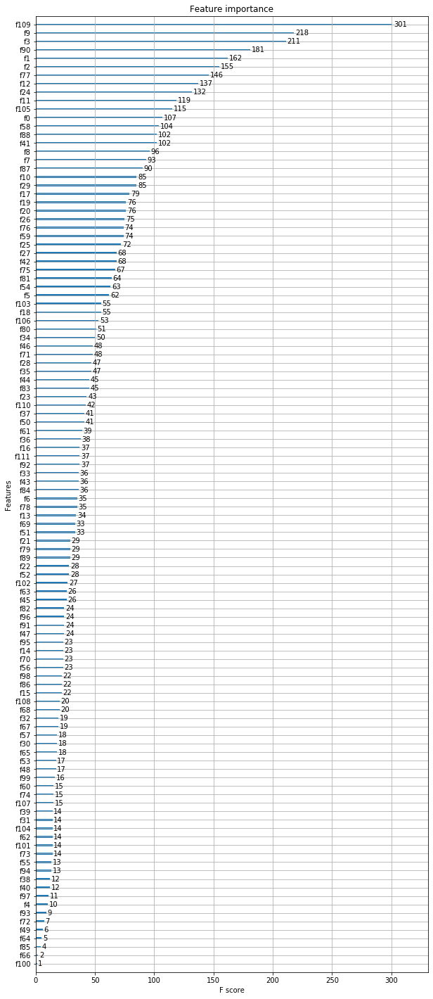

In [83]:
plot_features(bst, (10,25))

### 役に立つ特徴量

In [122]:
cols = list(training.columns)

del cols[cols.index('item_cnt_month')]
[cols[x] for x in [109, 9,3, 90,1,2,77,12,24,11,105, 0, 58, 88, 41, 8, 7, 87, 10, 29, 17, 19, 20, 26, 76, 59, 25, 27]]

['month',
 'item_cnt_day_per_item_lag_1',
 'item_category_id',
 'item_cnt_month_subtype_shop_lag_1',
 'item_id',
 'date_block_num',
 'price_std_per_item_lag_1',
 'sales_std_per_item_lag_1',
 'item_cnt_month_lag_1',
 'cnt_day_std_per_item_lag_1',
 'item_cnt_month_subtype_shop_lag_2',
 'shop_id',
 'item_cnt_month_lag_3',
 'item_cnt_month_subtype_lag_1',
 'item_cnt_month_lag_2',
 'product_sales_lag_1',
 'subtype',
 'item_cnt_month_per_type_lag_1',
 'sales_per_item_lag_1',
 'sales_std_per_item_lag_2',
 'item_cnt_day_per_category_lag_1',
 'cnt_day_std_per_category_lag_1',
 'sales_std_per_category_lag_1',
 'item_cnt_day_per_item_lag_2',
 'item_price_per_item_lag_1',
 'product_sales_lag_6',
 'product_sales_lag_2',
 'sales_per_item_lag_2']

### 役に立たない特徴量

In [121]:
cols = list(training.columns)

del cols[cols.index('item_cnt_month')]
[cols[x] for x in [100, 66, 85, 64, 49, 72, 93, 4, 97, 40, 38]]

['max_price_cat_shop_lag_2',
 'cnt_day_std_shop_lag_6',
 'max_price_cat_shop_lag_1',
 'item_cnt_day_per_shop_lag_6',
 'cnt_day_std_shop_lag_3',
 'cnt_day_shop_cat_lag_6',
 'item_price_per_shop_lag_2',
 'city_name',
 'price_shop_cat_lag_2',
 'item_cnt_day_city_cat_lag_2',
 'cnt_day_shop_cat_lag_2']

In [86]:
xgb_val_predict = xgb.DMatrix(X_valid.values)
val_pred = bst.predict(xgb_val_predict)

pd.Series(val_pred).describe()

count    238172.000000
mean          0.279430
std           0.755422
min          -0.747559
25%           0.033212
50%           0.101665
75%           0.251252
max          20.429359
dtype: float64

In [87]:
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing

In [88]:
category_feat_drop = ['days','type','city_name']

In [89]:
# X_train_lr_pickle = training.drop(category_feat, axis=1)

# for feat in X_train_lr.columns:
#     X_train_lr[feat] = X_train_lr[feat].fillna(X_train_lr[feat].median())

In [90]:
# X_train_lr.date_block_num = X_train_lr.date_block_num.astype(str)
# X_train_lr.to_csv('lr_dataframe.csv',index=False)
# X_train_lr.date_block_num = pd.get_dummies(X_train_lr.date_block_num,sparse=False)      
# scaler = preprocessing.StandardScaler()

# X_train_lr = scaler.fit_transform(X_train_lr)

In [91]:
# lr = LinearRegression()

# lr.fit(X_train_lr, training['item_cnt_month'])

In [92]:
#ensembleのためにpickleファイルに保存する
#training.to_pickle('data.pkl')

In [93]:
for lag in tqdm_notebook(lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num', 'shop_id','item_id'] + lag_cnt_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_feat + '_lag_'  + str(lag) for lag_feat in lag_cnt_variables]
    test = pd.merge(test, sales_new_df, on=['date_block_num','shop_id','item_id'],how='left')

In [94]:
for lag in tqdm_notebook(delta_lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num', 'shop_id','item_id'] + lag_price_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_feat + '_lag_'  + str(lag) for lag_feat in lag_price_variables]
    test = pd.merge(test, sales_new_df, on=['date_block_num','shop_id','item_id'],how='left')

In [95]:
test.head(10)

,ID,shop_id,item_id,date_block_num,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales_lag_1,item_cnt_day_per_item_lag_1,sales_per_item_lag_1,cnt_day_std_per_item_lag_1,sales_std_per_item_lag_1,item_cnt_day_per_shop_lag_1,sales_per_shop_lag_1,cnt_day_std_shop_lag_1,sales_std_per_shop_lag_1,item_cnt_day_per_category_lag_1,sales_per_category_lag_1,cnt_day_std_per_category_lag_1,sales_std_per_category_lag_1,cnt_day_shop_cat_lag_1,item_cnt_day_city_lag_1,item_cnt_day_city_cat_lag_1,item_cnt_month_lag_1,product_sales_lag_2,item_cnt_day_per_item_lag_2,sales_per_item_lag_2,cnt_day_std_per_item_lag_2,sales_std_per_item_lag_2,item_cnt_day_per_shop_lag_2,sales_per_shop_lag_2,cnt_day_std_shop_lag_2,sales_std_per_shop_lag_2,item_cnt_day_per_category_lag_2,sales_per_category_lag_2,cnt_day_std_per_category_lag_2,sales_std_per_category_lag_2,cnt_day_shop_cat_lag_2,item_cnt_day_city_lag_2,item_cnt_day_city_cat_lag_2,item_cnt_month_lag_2,product_sales_lag_3,item_cnt_day_per_item_lag_3,sales_per_item_lag_3,cnt_day_std_per_item_lag_3,sales_std_per_item_lag_3,item_cnt_day_per_shop_lag_3,sales_per_shop_lag_3,cnt_day_std_shop_lag_3,sales_std_per_shop_lag_3,item_cnt_day_per_category_lag_3,sales_per_category_lag_3,cnt_day_std_per_category_lag_3,sales_std_per_category_lag_3,cnt_day_shop_cat_lag_3,item_cnt_day_city_lag_3,item_cnt_day_city_cat_lag_3,item_cnt_month_lag_3,product_sales_lag_6,item_cnt_day_per_item_lag_6,sales_per_item_lag_6,cnt_day_std_per_item_lag_6,sales_std_per_item_lag_6,item_cnt_day_per_shop_lag_6,sales_per_shop_lag_6,cnt_day_std_shop_lag_6,sales_std_per_shop_lag_6,item_cnt_day_per_category_lag_6,sales_per_category_lag_6,cnt_day_std_per_category_lag_6,sales_std_per_category_lag_6,cnt_day_shop_cat_lag_6,item_cnt_day_city_lag_6,item_cnt_day_city_cat_lag_6,item_cnt_month_lag_6,item_price_per_item_lag_1,price_std_per_item_lag_1,item_price_per_shop_lag_1,price_std_per_shop_lag_1,item_price_per_category_lag_1,price_std_per_category_lag_1,price_shop_cat_lag_1,item_price_city_lag_1,item_price_city_cat_lag_1,max_price_cat_shop_lag_1,min_price_cat_shop_lag_1,item_cnt_month_per_type_lag_1,item_cnt_month_subtype_lag_1,item_cnt_month_subtype_city_lag_1,item_cnt_month_subtype_shop_lag_1,item_price_per_item_lag_2,price_std_per_item_lag_2,item_price_per_shop_lag_2,price_std_per_shop_lag_2,item_price_per_category_lag_2,price_std_per_category_lag_2,price_shop_cat_lag_2,item_price_city_lag_2,item_price_city_cat_lag_2,max_price_cat_shop_lag_2,min_price_cat_shop_lag_2,item_cnt_month_per_type_lag_2,item_cnt_month_subtype_lag_2,item_cnt_month_subtype_city_lag_2,item_cnt_month_subtype_shop_lag_2
0,0,5,5037,34,"NHL 15 [PS3, русские субтитры]",19,3,0.016667,5,12,0.0,1.000000,1499.000000,0.000000,0.000000,1.090155,1140.12439,0.449938,2012.336304,1.041791,1785.249023,0.304898,1260.846924,1.013514,0.190098,0.513699,0.0,699.0,1.428571,1258.038940,1.657746,1266.470825,1.148265,1231.808594,0.877853,2667.791748,1.273688,1863.874756,1.332492,3326.656006,1.195652,0.2059,0.696203,1.0,699.0,1.190000,1036.971558,0.544857,457.709259,1.080134,969.072205,0.41916,1915.93335,1.126207,1239.744751,0.519704,765.679199,1.062016,0.245106,0.830303,3.0,699.0,1.087500,1656.543701,0.284349,583.962952,1.143503,1171.629395,0.902971,3209.707275,1.061991,1494.353638,0.407311,877.990784,1.013699,0.180011,0.432749,1.0,1499.00000,0.000000,1030.721924,1654.235107,1681.477905,835.197998,1548.945923,55.246517,202.424652,699.0,0.0,0.494105,0.337299,0.447059,0.447059,941.385193,327.270966,1034.784302,1661.687866,1358.810913,846.124573,1355.232666,58.403263,206.332275,699.0,0.0,0.611331,0.521406,0.647727,0.647727
1,1,5,5320,34,ONE DIRECTION Made In The A.M.,55,3,0.016667,13,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [97]:
beta_mean_feat = ['item_cnt_day_per_item','item_cnt_day_per_shop','item_cnt_day_per_category']

for feat in beta_mean_feat:
    mean = np.zeros(len(test))
    for lag in [1,2,3]:
        mean += test[feat + '_lag_' + str(lag)]/3
    test[feat + '_mean_3'] = mean

In [98]:
test = test.drop(['ID','item_name'], axis=1)

In [99]:
for feat in test.columns:
    if 'cnt' in feat:
        test[feat] = test[feat].fillna(0)
    elif 'price' in feat:
        test[feat] = test[feat].fillna(test[feat].median())

In [100]:
test['month'] = test['date_block_num'] % 12
test['month'] = test['month'].astype(np.int8)
test['days'] = 30

In [101]:
test['item_shop_last_sale'] = -1
test['item_shop_last_sale'] = test['item_shop_last_sale'].astype(np.int8)
for row in test.itertuples():
    idx = getattr(row, 'Index')
    item_id = getattr(row, 'item_id')
    shop_id = getattr(row, 'shop_id')
    date_block_num = getattr(row, 'date_block_num')
    key = str(item_id) + ' ' + str(shop_id)
    if key  in cache:
        last_date_block_num = cache[key]
        test.at[idx, 'item_shop_last_sale'] = date_block_num - last_date_block_num
        

test[['item_id','shop_id', 'item_shop_last_sale']].to_pickle('test_item_shop_last_sale.pkl')

# test_item_shop_last_sale = pd.read_pickle('test_item_shop_last_sale.pkl')
# test = pd.merge(test, test_item_shop_last_sale, on=['item_id','shop_id'], how='left')

In [102]:
#test.to_pickle('test_data.pkl')

In [103]:
xgbpredict = xgb.DMatrix(test.values)

In [104]:
test.columns[-20:]

Index(['price_std_per_item_lag_2', 'item_price_per_shop_lag_2',
       'price_std_per_shop_lag_2', 'item_price_per_category_lag_2',
       'price_std_per_category_lag_2', 'price_shop_cat_lag_2',
       'item_price_city_lag_2', 'item_price_city_cat_lag_2',
       'max_price_cat_shop_lag_2', 'min_price_cat_shop_lag_2',
       'item_cnt_month_per_type_lag_2', 'item_cnt_month_subtype_lag_2',
       'item_cnt_month_subtype_city_lag_2',
       'item_cnt_month_subtype_shop_lag_2', 'item_cnt_day_per_item_mean_3',
       'item_cnt_day_per_shop_mean_3', 'item_cnt_day_per_category_mean_3',
       'month', 'days', 'item_shop_last_sale'],
      dtype='object')

In [105]:
training.columns[-20:]

Index(['price_std_per_item_lag_2', 'item_price_per_shop_lag_2',
       'price_std_per_shop_lag_2', 'item_price_per_category_lag_2',
       'price_std_per_category_lag_2', 'price_shop_cat_lag_2',
       'item_price_city_lag_2', 'item_price_city_cat_lag_2',
       'max_price_cat_shop_lag_2', 'min_price_cat_shop_lag_2',
       'item_cnt_month_per_type_lag_2', 'item_cnt_month_subtype_lag_2',
       'item_cnt_month_subtype_city_lag_2',
       'item_cnt_month_subtype_shop_lag_2', 'item_cnt_day_per_item_mean_3',
       'item_cnt_day_per_shop_mean_3', 'item_cnt_day_per_category_mean_3',
       'month', 'days', 'item_shop_last_sale'],
      dtype='object')

In [106]:
diff = list( set(training.columns) -set(test.columns))
diff

['item_cnt_month']

In [107]:
pred = bst.predict(xgbpredict)

In [108]:
# X_test_lr = test.drop(category_feat, axis=1)

# for feat in X_test_lr.columns:
#     X_test_lr[feat] = X_test_lr[feat].fillna(X_test_lr[feat].median())

# X_test_lr["date_block_num"] = X_test_lr.date_block_num.astype(str)
# X_test_lr.to_csv('lr_test.csv',index=False)
# X_test_lr["date_block_num"] = pd.get_dummies(X_test_lr.date_block_num,sparse=False)

In [109]:
# X_test_lr = scaler.fit_transform(X_test_lr)
# pred_lr = lr.predict(X_test_lr)
# pred_lr = pred_lr.clip(0,20)

In [110]:
pd.Series(pred).describe()

count    214200.000000
mean          0.309711
std           0.793970
min          -0.663446
25%           0.034679
50%           0.117917
75%           0.297859
max          21.196756
dtype: float64

In [111]:
# pd.Series(pred_lr).describe()

In [112]:
pred = pred.clip(0,20)

## 標準偏差を付け加えた時と線形回帰とxbgboostの結果。スコアは0.94と1.10

In [113]:
pd.Series(pred).describe()

count    214200.000000
mean          0.311516
std           0.792444
min           0.000000
25%           0.034679
50%           0.117917
75%           0.297859
max          20.000000
dtype: float64

In [114]:
sub_df = pd.DataFrame({'ID':test.index,'item_cnt_month':pred})

In [115]:
#  sub_lr_df = pd.DataFrame({'ID':test.index,'item_cnt_month':pred_lr})

In [116]:
sub_df.head()

,ID,item_cnt_month
0,0,0.508156
1,1,0.357192
2,2,1.839100
3,3,0.613337
4,4,2.903669


In [117]:
sub_df.to_csv('early_stop_xgb_last_sale.csv',index=False)

In [118]:
#sub_lr_df.to_csv('lr_std.csv',index=False)